In [1]:
import os
os.environ["OMP_NUM_THREADS"]="1"
import random
import torch
import torch.nn.functional as F
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter
from torchvision.transforms import transforms
import numpy as np
import toml
from time import time
import segmentation_models_pytorch as smp
from torchvision.transforms.transforms import RandomApply, GaussianBlur, ColorJitter
from src.data_utils import GaussianNoise
from src.color_conversion import Rgb2Hed, Hed2Rgb, LinearContrast
from src.embedding_loss import SpatialEmbLoss
from src.focal_loss import FocalCE
from src.unet import UNet
from src.multi_head_unet import UnetDecoder, MultiHeadModel
from src.spatial_augmenter import SpatialAugmenter
from src.train_utils import instance_seg_train_step, instance_seg_validation, save_snapshot, save_model, make_cpvs
from src.data_utils import SliceDataset, CropDataset, color_augmentations, add_3c_gt
#import torch_optimizer as optim

torch.backends.cudnn.benchmark = True

torch.manual_seed(42)

params = {
    'data_path': 'tiles',
    'experiment' : 'instance_seg_PPP',
    'batch_size': 2,
    'training_steps':400000,
    'in_channels': 3,
    'num_fmaps': 32,
    'fmap_inc_factors': 2,
    'downsample_factors': [ [ 2, 2,], [ 2, 2,], [ 2, 2,], [ 2, 2,],],
    'num_fmaps_out': 5,
    'constant_upsample': False,
    'padding': 'same',
    'activation': 'ReLU',
    'weight_decay': 1e-5,
    'learning_rate': 3e-4,
    'seed': 42,
    'num_validation': 500,
    'checkpoint_path': None, # 'exp_0_dsb/best_model',
    'pretrained_model': True,
    'multi_head': False,
    'uniform_class_sampling': False,
    'optimizer': 'AdamW', # one of SGD AdamW AdaBound , Adahessian breaks memory and is not supported
    'validation_step' : 500,
    'snapshot_step' : 5000,
    'checkpoint_step': 20000,
    'instance_seg': 'embedding', # 'embedding' or 'cpv_3c'
    'attention': True,
    'color_augmentation_s': 0.4,
    'to_center': True
    }

aug_params_fast = {
    'mirror': {'prob_x': 0.5, 'prob_y': 0.5, 'prob': 0.5},
    'translate': {'max_percent':0.05, 'prob': 0.2},
    'scale': {'min': 0.8, 'max':1.2, 'prob': 0.2},
    'zoom': {'min': 0.8, 'max':1.2, 'prob': 0.2},
    'rotate': {'max_degree': 179, 'prob': 0.75},
    'shear': {'max_percent': 0.1, 'prob': 0.2},
    'elastic': {'alpha': [120,120], 'sigma': 8, 'prob': 0.5}
}

log_dir = os.path.join(params['experiment'],'train')
snap_dir = os.path.join(log_dir,'snaps')
os.makedirs(snap_dir,exist_ok=True)
writer_dir = os.path.join(log_dir,'summary',str(time()))
os.makedirs(writer_dir,exist_ok=True)
writer = SummaryWriter(writer_dir)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)
params['device'] = device
params['aug_params_fast'] = aug_params_fast
with open(os.path.join(params['experiment'], 'params.toml'), 'w') as f:
    toml.dump(params, f)

if 'tiles' in params['data_path']:
    img_data =  np.load(os.path.join(params['data_path'], 'images.npy')) # N x H x W x C
    lab_dat = np.load(os.path.join(params['data_path'], 'labels.npy')) # N x H x W x 2
    np.random.seed(params['seed'])
    seed_ind = np.random.permutation(img_data.shape[0])
    img_data = img_data[seed_ind]
    lab_dat = lab_dat[seed_ind]
    X_train = img_data[:-params['num_validation']]
    Y_train = lab_dat[:-params['num_validation']]
    X_val = img_data[-params['num_validation']:]
    Y_val = lab_dat[-params['num_validation']:]
    # add gt_3c
    if params['instance_seg'] == 'cpv_3c':
        print('Add 3c labels')
        Y_train = add_3c_gt(Y_train)
        Y_val = add_3c_gt(Y_val)
    labeled_dataset = SliceDataset(raw=X_train, labels=Y_train)
    validation_dataset = SliceDataset(raw=X_val, labels=Y_val)
else:
    file_paths = [os.path.join(params['data_path'], file) for file in os.listdir(params['data_path'])]
    random.Random(params['seed']).shuffle(file_paths)
    val_paths = [file_paths.pop(0) for _ in range(params['num_validation'])]
    labeled_paths = file_paths
    labeled_dataset = CropDataset(labeled_paths, raw_keys=['raw'], label_keys=['gt_labels', 'gt_instances'], crop_size=[256,256])
    validation_dataset = CropDataset(val_paths, raw_keys=['raw'], label_keys=['gt_labels', 'gt_instances'], crop_size=[256,256])

if params['uniform_class_sampling']:
    print('Uniform class sampling')
    # uniform class sampling
    labeled_dataloader = DataLoader(labeled_dataset,
                        batch_size=1,
                        shuffle=False,
                        prefetch_factor=4,
                        num_workers=6)
    classes = [0,1,2,3,4,5,6]
    count_list = []

    for raw, gt in labeled_dataloader:
        gt_classes = gt[...,1].squeeze()
        tmp_list = []
        for c in classes:
            tmp_list.append(torch.sum(gt_classes==c)) # sum of individual classes for a sample
        count_list.append(torch.stack(tmp_list)) # 
        
    counts = torch.stack(count_list) # n_samples x classes 
    sampling_weights = counts/counts.sum(0).unsqueeze(0) # n_samples x classes / 1 x classes = n_samples x classes
    sampling_weights = sampling_weights.sum(1) # n_samples
    sampler = torch.utils.data.WeightedRandomSampler(sampling_weights, num_samples=len(sampling_weights), replacement=True)

    labeled_dataloader = DataLoader(labeled_dataset,
                        batch_size=1,
                        prefetch_factor=4,
                        sampler=sampler,
                        num_workers=6)
else:
    labeled_dataloader = DataLoader(labeled_dataset,
                        batch_size=params['batch_size'],
                        shuffle=True,
                        prefetch_factor=4,
                        num_workers=6)

validation_dataloader = DataLoader(validation_dataset,
                    batch_size=1,
                    shuffle=True,
                    prefetch_factor=4,
                    num_workers=1)

if params['pretrained_model']:
    if params['multi_head']:
        encoder = smp.encoders.get_encoder(
            name= "timm-efficientnet-b5",
            in_channels=3,
            depth=5,
            weights="imagenet").to(device)
        decoder_channels = (256, 128, 64, 32, 16)
        decoder_inst = UnetDecoder(
                    encoder_channels=encoder.out_channels,
                    decoder_channels=decoder_channels,
                    n_blocks=5,
                    use_batchnorm=True,
                    center=False,
                    attention_type='scse' if params['attention'] else None
                    ).to(device)
        decoder_ct = UnetDecoder(
                    encoder_channels=encoder.out_channels,
                    decoder_channels=decoder_channels,
                    n_blocks=5,
                    use_batchnorm=True,
                    center=False,
                    attention_type='scse' if params['attention'] else None
                    ).to(device)
        head_inst = smp.base.SegmentationHead(
                    in_channels=decoder_channels[-1],
                    out_channels=5,
                    activation=None,
                    kernel_size=1).to(device)
        head_ct = smp.base.SegmentationHead(
                    in_channels=decoder_channels[-1],
                    out_channels=7,
                    activation=None,
                    kernel_size=1).to(device)

        decoders = [decoder_inst, decoder_ct]
        heads = [head_inst, head_ct]
        model = MultiHeadModel(encoder, decoders, heads)
    else:
        model = smp.Unet(
            encoder_name= "timm-efficientnet-b5", # "timm-efficientnet-b5", # choose encoder
            encoder_weights="imagenet",     # use `imagenet` pre-trained weights for encoder initialization
            in_channels=3,                  # model input channels (1 for gray-scale images, 3 for RGB, etc.)
            classes=params['num_fmaps_out'],                      # model output channels (number of classes in your dataset)
            decoder_attention_type='scse' if params['attention'] else None,
            ).to(params['device'])
#preprocess_input = smp.encoders.get_preprocessing_fn('efficientnet-b5', pretrained='imagenet')
else:
    model = UNet(in_channels = params['in_channels'],
                num_fmaps = params['num_fmaps'],
                fmap_inc_factor = params['fmap_inc_factors'],
                downsample_factors = params['downsample_factors'],
                activation = params['activation'],
                padding = params['padding'],
                num_fmaps_out = params['num_fmaps_out'],
                constant_upsample = params['constant_upsample'],
            ).to(params['device'])

if 'checkpoint_path' in params.keys() and params['checkpoint_path']:
    model.load_state_dict(torch.load(params['checkpoint_path'])['model_state_dict'])
model = model.train()

# initialize optimizer, augmentations and summary writer
if params['optimizer'] == 'SGD':
    optimizer = torch.optim.SGD(model.parameters(),
                                lr=params['learning_rate'],
                                momentum=0.9,
                                weight_decay=params['weight_decay'],
                                nesterov=True)
elif params['optimizer'] == 'AdamW':
    optimizer = torch.optim.AdamW(model.parameters(),
                                  lr=params['learning_rate'],
                                  weight_decay=params['weight_decay'])

lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=params['training_steps'], eta_min=5e-6)
fast_aug = SpatialAugmenter(aug_params_fast)#, padding_mode='reflection')
if params['instance_seg'] == 'embedding':
    inst_loss_fn = SpatialEmbLoss(n_sigma=2, to_center=params['to_center'], foreground_weight=10, H=256,W=256).to(device)
elif params['instance_seg'] == 'cpv_3c':
    def inst_loss_fn(input, gt_inst, gt_3c):
        gt_cpv_list = []
        gt_inst = gt_inst.squeeze(0)
        for b in range(gt_inst.shape[0]):
            gt_cpv_list.append(make_cpvs(gt_inst.to(device)[b], device))
        gt_cpv = torch.cat(gt_cpv_list, axis=0)
        loss_cpv = F.mse_loss(input = input[:,:2],target = gt_cpv.float())
        loss_3c =  F.cross_entropy(input = input[:,2:],
                        target = gt_3c.long().squeeze(0).to(device),
                        weight=torch.tensor([1,1,2]).float().to(device))
        return loss_cpv + loss_3c

def color_augmentations(size, s=0.5):
    # taken from https://github.com/sthalles/SimCLR/blob/master/data_aug/contrastive_learning_dataset.py
    """Return a set of data augmentation transformations as described in the SimCLR paper."""
    color_jitter = ColorJitter(0.8 * s, 0.0 * s, 0.8 * s, 0.2 * s) # brightness, contrast, saturation, hue
    HED_contrast = torch.nn.Sequential(
                Rgb2Hed(),
                LinearContrast(alpha=(0.75,1.25)),
                Hed2Rgb())
    data_transforms = torch.nn.Sequential(
        RandomApply([
            HED_contrast,
            color_jitter,
            GaussianNoise(0.005), 
            GaussianBlur(kernel_size=3, sigma=(0.1,0.1))], p=0.5),
        )
    return data_transforms

color_aug_fn = color_augmentations(200, s=params['color_augmentation_s'])
validation_loss = []
step = -1

def supervised_training(params):
    step = -1
    while step < params['training_steps']:
        tmp_loader = iter(labeled_dataloader)
        for raw, gt in tmp_loader:
            step += 1
            optimizer.zero_grad()
            loss, pred_inst,img_caug, gt_inst = instance_seg_train_step(model,
                                                                raw,
                                                                gt,
                                                                fast_aug,
                                                                color_aug_fn,
                                                                inst_loss_fn,
                                                                writer,
                                                                device,
                                                                step,
                                                                inst_model=params['instance_seg'])
            if torch.isnan(loss) or not torch.isfinite(loss):
                continue
            loss.backward()
            optimizer.step()
            #lr_scheduler.step()
            if step % params['validation_step'] == 0:
                val_new = instance_seg_validation(model,
                        validation_dataloader,
                        inst_loss_fn,
                        device,
                        step,
                        writer,
                        inst_model=params['instance_seg'])
                validation_loss.append(val_new)
                if val_new <= np.min(validation_loss):
                    print('Save best model')
                    save_model(step, model, optimizer, loss, os.path.join(log_dir,"best_model"))
            #
            if step % params['snapshot_step'] == 0:
                print('Save snapshot')
                tmp_dic = {
                        'img_caug': img_caug[0].squeeze(0).cpu().detach().numpy(),
                        'gt_inst': gt_inst.squeeze(0).cpu().detach().numpy()[:1]}
                if params['instance_seg'] == 'embedding':
                    _,_,h,w = pred_inst.shape
                    xym_s = inst_loss_fn.xym[:, 0:h, 0:w].contiguous()
                    spatial_emb = pred_inst[0, 0:2] + xym_s  # 2 x h x w
                    sigma = pred_inst[0, 2:2+inst_loss_fn.n_sigma]  # n_sigma x h x w
                    seed_map = torch.sigmoid(
                        pred_inst[0, 2+inst_loss_fn.n_sigma:2+inst_loss_fn.n_sigma + 1])  # 1 x h x w
                    tmp_dic['embedding'] = spatial_emb.cpu().detach().numpy()
                    tmp_dic['sigma'] = sigma.cpu().detach().numpy()
                    tmp_dic['seed_map'] = seed_map.cpu().detach().numpy()
                elif params['instance_seg'] == 'cpv_3c':
                    tmp_dic['pred_cpv'] = pred_inst[0,:2].cpu().detach().numpy()
                    tmp_dic['pred_3c'] = pred_inst[0,2:].softmax(0).cpu().detach().numpy()
                save_snapshot(snap_dir, tmp_dic, step)
            if step % params['checkpoint_step'] == 0:
                save_model(step, model, optimizer, loss, os.path.join(log_dir,"checkpoint_step_"+str(step)))    

cuda:1
Created spatial emb loss function with: to_center: True, n_sigma: 2, foreground_weight: 10


In [6]:
from src.cluster import Cluster
import matplotlib.pyplot as plt
cl = Cluster(grid_y=256, grid_x=256, pixel_y=1, pixel_x=1)

inst_loss_fn = SpatialEmbLoss(n_sigma=2, to_center=params['to_center'], foreground_weight=3, H=256,W=256).to(device)

def cvp_loss_fn(input, gt_inst):
    gt_inst = gt_inst.squeeze(0)
    gt_cpv_list = []
    for b in range(gt_inst.shape[0]):
        gt_cpv_list.append(make_cpvs(gt_inst.to(device)[b], device))
    gt_cpv = torch.cat(gt_cpv_list, axis=0)/255.0
    loss_cpv = F.mse_loss(input = input[:,:2].tanh(),target = gt_cpv.float())
    return loss_cpv

def supervised_training(params):
    step = 21000
    while step < params['training_steps']:
        tmp_loader = iter(labeled_dataloader)
        for raw, gt in tmp_loader:
            step += 1
            optimizer.zero_grad()
            loss, pred_inst,img_caug, gt_inst = instance_seg_train_step(model,
                                                                raw,
                                                                gt,
                                                                fast_aug,
                                                                color_aug_fn,
                                                                inst_loss_fn,
                                                                writer,
                                                                device,
                                                                step,
                                                                inst_model=params['instance_seg'])
            #cvp_loss = cvp_loss_fn(pred_inst, gt_inst)*128
            #print(cvp_loss)
            #loss += cvp_loss
            if torch.isnan(loss) or not torch.isfinite(loss):
                continue
            loss.backward()
            optimizer.step()
            #lr_scheduler.step()
            if step% 100==0:
                instance_map, instances = cl.cluster(pred_inst[0].cuda().detach(), min_mask_sum=4, min_object_size=2)
                fig, ax = plt.subplots(1,3,figsize=(30,30))
                ax[0].imshow(img_caug[0].permute(1,2,0).cpu().detach().numpy())
                ax[1].imshow(instance_map.detach().cpu().squeeze().cpu())
                ax[2].imshow(gt_inst[:,0].squeeze().detach().cpu())
                plt.show()
            if step % params['validation_step'] == 0:
                val_new = instance_seg_validation(model,
                        validation_dataloader,
                        inst_loss_fn,
                        device,
                        step,
                        writer,
                        inst_model=params['instance_seg'])
                validation_loss.append(val_new)
                if val_new <= np.min(validation_loss):
                    print('Save best model')
                    save_model(step, model, optimizer, loss, os.path.join(log_dir,"best_model"))
            #
            if step % params['snapshot_step'] == 0:
                print('Save snapshot')
                tmp_dic = {
                        'img_caug': img_caug[0].squeeze(0).cpu().detach().numpy(),
                        'gt_inst': gt_inst.squeeze(0).cpu().detach().numpy()[:1]}
                if params['instance_seg'] == 'embedding':
                    instance_map, instances = cl.cluster(pred_inst[0].cuda().detach(), min_mask_sum=10, min_object_size=5)
                    _,_,h,w = pred_inst.shape
                    xym_s = inst_loss_fn.xym[:, 0:h, 0:w].contiguous()
                    spatial_emb = pred_inst[0, 0:2] + xym_s  # 2 x h x w
                    sigma = pred_inst[0, 2:2+inst_loss_fn.n_sigma]  # n_sigma x h x w
                    seed_map = torch.sigmoid(
                        pred_inst[0, 2+inst_loss_fn.n_sigma:2+inst_loss_fn.n_sigma + 1])  # 1 x h x w
                    tmp_dic['embedding'] = spatial_emb.cpu().detach().numpy()
                    tmp_dic['sigma'] = sigma.cpu().detach().numpy()
                    tmp_dic['seed_map'] = seed_map.cpu().detach().numpy()
                    tmp_dic['pred_inst'] = instance_map.cpu().detach().numpy()
                elif params['instance_seg'] == 'cpv_3c':
                    tmp_dic['pred_cpv'] = pred_inst[0,:2].cpu().detach().numpy()
                    tmp_dic['pred_3c'] = pred_inst[0,2:].softmax(0).cpu().detach().numpy()
                save_snapshot(snap_dir, tmp_dic, step)
            if step % params['checkpoint_step'] == 0:
                save_model(step, model, optimizer, loss, os.path.join(log_dir,"checkpoint_step_"+str(step)))  

Created spatial emb loss function with: to_center: True, n_sigma: 2, foreground_weight: 3


loss 0.6487540602684021
loss 0.704416036605835
loss 0.731960117816925
loss 0.6169425249099731
loss 0.7457417249679565
loss 0.7073319554328918
loss 0.6683019399642944
loss 0.7196078300476074
loss 0.7750846147537231
loss 0.7392977476119995
loss 0.7753463983535767
loss 0.6607571840286255
loss 0.6807107925415039
loss 0.7977124452590942
loss 0.6692782640457153
loss 0.671828031539917
loss 0.5756292343139648
loss 0.7211278676986694
loss 0.8561341762542725
loss 0.7662914991378784
loss 0.7052551507949829
loss 0.6694134473800659
loss 0.5977661609649658
loss 0.6426810026168823
loss 0.6959388256072998
loss 0.7809773087501526
loss 0.749579668045044
loss 0.7180240154266357
loss 0.8664761781692505
loss 0.7122374176979065
loss 0.7577414512634277
loss 0.7049155235290527
loss 0.6563372611999512
loss 0.6512241363525391
loss 0.653785765171051
loss 0.6910594701766968
loss 0.6686539649963379
loss 0.7264894247055054
loss 0.5784187316894531
loss 0.7117843627929688
loss 0.6411383152008057
loss 0.63986051082611

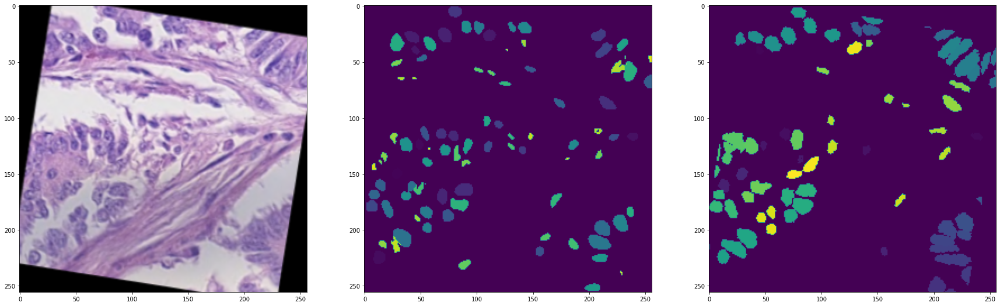

loss 0.693217396736145
loss 0.7485870122909546
loss 0.7125709056854248
loss 0.7451087236404419
loss 0.7135294079780579
loss 0.743880033493042
loss 0.6663829684257507
loss 0.7325214743614197
loss 0.752177357673645
loss 0.7753726243972778
loss 0.6751583814620972
loss 0.6259408593177795
loss 0.673176646232605
loss 0.34895697236061096
loss 0.745159387588501
loss 0.7549679279327393
loss 0.626991868019104
loss 0.7457802295684814
loss 0.6586572527885437
loss 0.7539306879043579
loss 0.7046686410903931
loss 0.6878186464309692
loss 0.8506416082382202
loss 0.8674228191375732
loss 0.34309902787208557
loss 0.732573926448822
loss 0.6972873210906982
loss 0.6466396450996399
loss 0.7643706798553467
loss 0.6854512095451355
loss 0.7273679375648499
loss 0.7326576709747314
loss 0.6715574264526367
loss 0.7374148368835449
loss 0.7163278460502625
loss 0.7777198553085327
loss 0.7337088584899902
loss 0.7441031336784363
loss 0.6645063161849976
loss 0.8283464908599854
loss 0.6728636622428894
loss 0.78264731168746

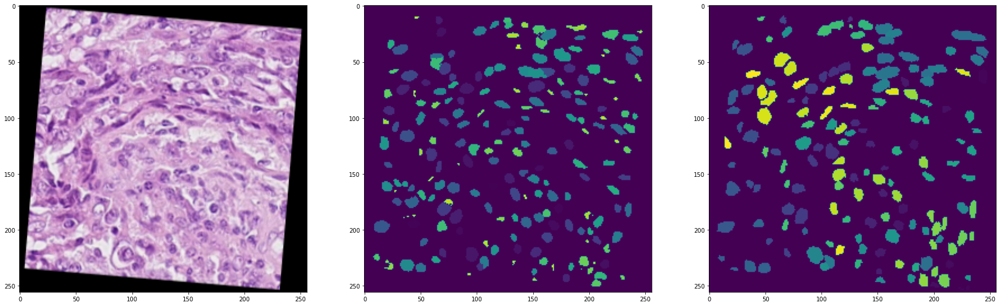

loss 0.6848388314247131
loss 0.7578157186508179
loss 0.8217912912368774
loss 0.7282166481018066
loss 0.7110823392868042
loss 0.6775542497634888
loss 0.6554280519485474
loss 0.6972472667694092
loss 0.6132420301437378
loss 0.5867710113525391
loss 0.7095552086830139
loss 0.6677157878875732
loss 0.6909770369529724
loss 0.6990067958831787
loss 0.6781930923461914
loss 0.35096046328544617
loss 0.7840098738670349
loss 0.7254796028137207
loss 0.31909599900245667
loss 0.6755790710449219
loss 0.6660955548286438
loss 0.6424217224121094
loss 0.7140110731124878
loss 0.6816744804382324
loss 0.5784188508987427
loss 0.6384473443031311
loss 0.6188379526138306
loss 0.6157553791999817
loss 0.6730481386184692
loss 0.6167083978652954
loss 0.7290449142456055
loss 0.7875431180000305
loss 0.7250720262527466
loss 0.7056432962417603
loss 0.6728441119194031
loss 0.6227977275848389
loss 0.7704964280128479
loss 0.6823247075080872
loss 0.6740683317184448
loss 0.7351441383361816
loss 0.6625291109085083
loss 0.7344697

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


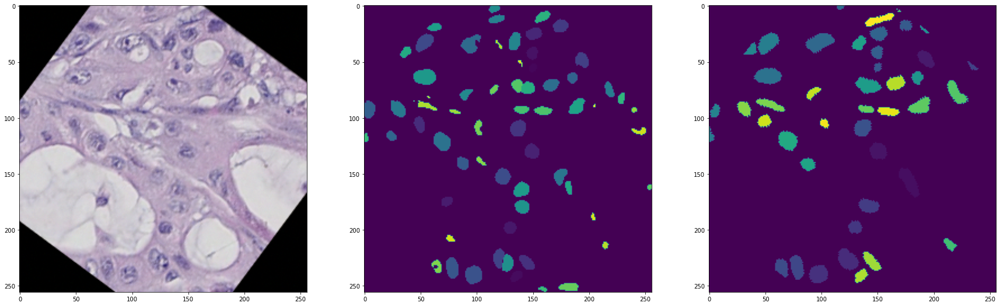

loss 0.31639209389686584
loss 0.6616098880767822
loss 0.8111242055892944
loss 0.7598724365234375
loss 0.704208254814148
loss 0.7340694069862366
loss 0.811823308467865
loss 0.7369542121887207
loss 0.7064417004585266
loss 0.3648226261138916
loss 0.7907825708389282
loss 0.7520465850830078
loss 0.7844340801239014
loss 0.7335833311080933
loss 0.6746313571929932
loss 0.7140287160873413
loss 0.734973669052124
loss 0.752810001373291
loss 0.7205051183700562
loss 0.3675503730773926
loss 0.7442176342010498
loss 0.6391191482543945
loss 0.7744501829147339
loss 0.6886136531829834
loss 0.743156373500824
loss 0.71230548620224
loss 0.781883716583252
loss 0.6640278100967407
loss 0.623975932598114
loss 0.8192657828330994
loss 0.674628734588623
loss 0.7480397820472717
loss 0.684878945350647
loss 0.8029897809028625
loss 0.7297884821891785
loss 0.7636464834213257
loss 0.7343005537986755
loss 0.6574878692626953
loss 0.7639269828796387
loss 0.7529182434082031
loss 0.7466115951538086
loss 0.6484873294830322
lo

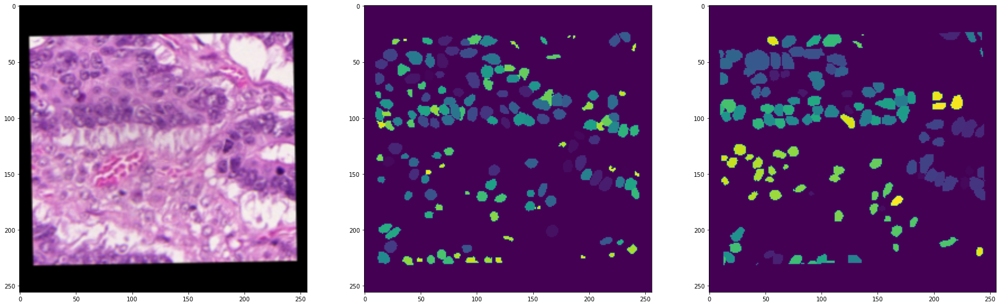

loss 0.7361353635787964
loss 0.7309609651565552
loss 0.7379214763641357
loss 0.33805739879608154
loss 0.775179386138916
loss 0.7476494312286377
loss 0.6995901465415955
loss 0.692192554473877
loss 0.597018837928772
loss 0.7542057633399963
loss 0.8207318782806396
loss 0.6627523303031921
loss 0.6299489736557007
loss 0.767565131187439
loss 0.7878556251525879
loss 0.7064145803451538
loss 0.3253706395626068
loss 0.7585435509681702
loss 0.6405143737792969
loss 0.7791019082069397
loss 0.7977250814437866
loss 0.6622411608695984
loss 0.7529613971710205
loss 0.6828464269638062
loss 0.7297307252883911
loss 0.7710354328155518
loss 0.6450050473213196
loss 0.828864574432373
loss 0.7408307790756226
loss 0.737804651260376
loss 0.7961286902427673
loss 0.7155594825744629
loss 0.6601659059524536
loss 0.7237037420272827
loss 0.6586582660675049
loss 0.7814148664474487
loss 0.7021317481994629
loss 0.6824824213981628
loss 0.741661548614502
loss 0.6980443000793457
loss 0.7947824001312256
loss 0.705978631973266

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


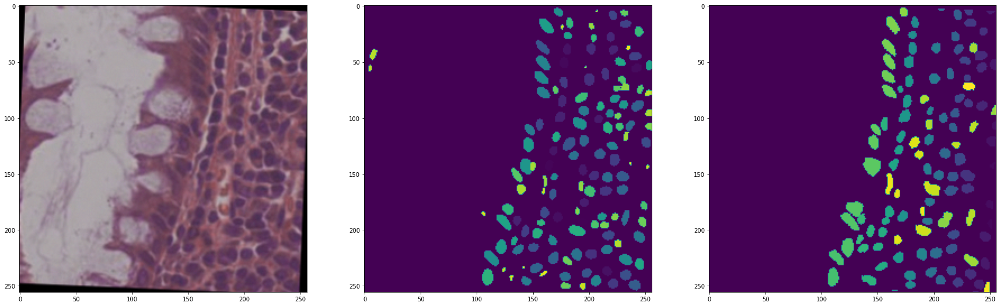

Validation loss:  0.8604286909103394
loss 0.40646371245384216
loss 0.7480001449584961
loss 0.7028070688247681
loss 0.7370729446411133
loss 0.6979424953460693
loss 0.7070285081863403
loss 0.6822372674942017
loss 0.6398694515228271
loss 0.6606034636497498
loss 0.46487191319465637
loss 0.9681033492088318
loss 0.7278407216072083
loss 0.6961212158203125
loss 0.7697586417198181
loss 0.3909280300140381
loss 0.6099465489387512
loss 0.7319141626358032
loss 0.6698304414749146
loss 0.7382248640060425
loss 0.6927770972251892
loss 0.8180304169654846
loss 0.7921240329742432
loss 0.6572332382202148
loss 0.7762711048126221
loss 0.8060975074768066
loss 0.645779013633728
loss 0.6768288612365723
loss 0.7322701215744019
loss 0.6874947547912598
loss 0.7019251585006714
loss 0.4464121460914612
loss 0.7742363214492798
loss 0.6642341613769531
loss 0.704304039478302
loss 0.6522583961486816
loss 0.6989569664001465
loss 0.666043758392334
loss 0.6824455261230469
loss 0.27825531363487244
loss 0.6938644051551819
los

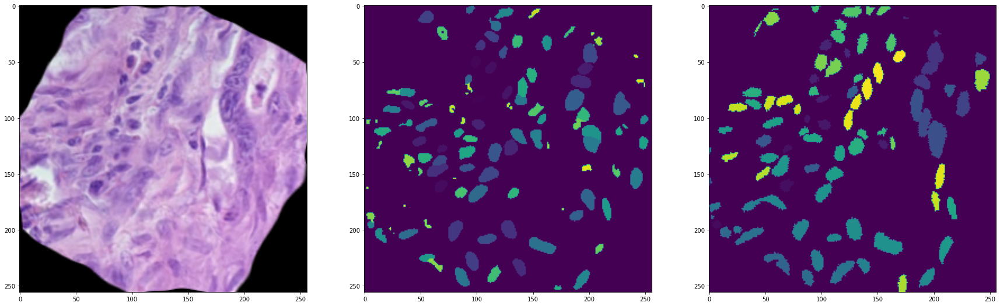

loss 0.7038562297821045
loss 0.722212553024292
loss 0.6848927736282349
loss 0.712936520576477
loss 0.6450205445289612
loss 0.7256655693054199
loss 0.7691978216171265
loss 0.614700436592102
loss 0.7061828374862671
loss 0.7067430019378662
loss 0.5941131114959717
loss 0.6608036756515503
loss 0.7174755930900574
loss 0.7492910623550415
loss 0.7407668828964233
loss 0.7719606161117554
loss 0.7216875553131104
loss 0.6367543935775757
loss 0.7124887704849243
loss 0.6976548433303833
loss 0.7558163404464722
loss 0.7152102589607239
loss 0.6865718364715576
loss 0.6338423490524292
loss 0.5910723209381104
loss 0.7403996586799622
loss 0.7102980613708496
loss 0.7263171672821045
loss 0.6788324117660522
loss 0.6618936061859131
loss 0.6889984011650085
loss 0.3854978084564209
loss 0.7157989740371704
loss 0.743758499622345
loss 0.7484514713287354
loss 0.6939269304275513
loss 0.6013147234916687
loss 0.6904081106185913
loss 0.690987765789032
loss 0.7122653722763062
loss 0.7000879049301147
loss 0.74487316608428

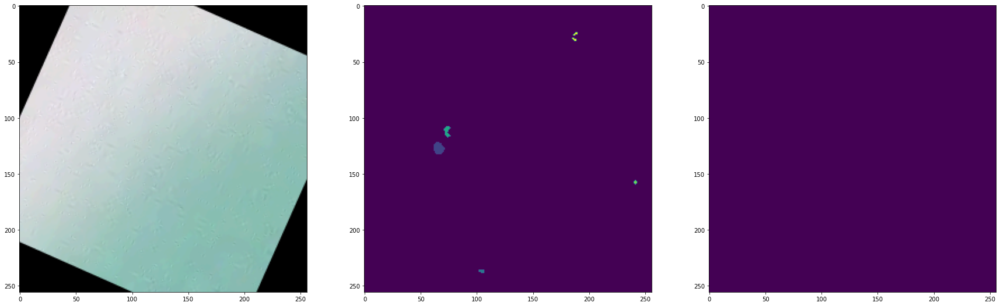

loss 0.6413722038269043
loss 0.6793678998947144
loss 0.708832859992981
loss 0.6752971410751343
loss 0.698775053024292
loss 0.6465340256690979
loss 0.6879655718803406
loss 0.40230587124824524
loss 0.7035854458808899
loss 0.6616618633270264
loss 0.7401713132858276
loss 0.7176552414894104
loss 0.7905782461166382
loss 0.6671003699302673
loss 0.6626067161560059
loss 0.6680489182472229
loss 0.7181349992752075
loss 0.5985860824584961
loss 0.4032275676727295
loss 0.7439733743667603
loss 0.7667537927627563
loss 0.8535308837890625
loss 0.6477855443954468
loss 0.708625316619873
loss 0.6137964725494385
loss 0.28177160024642944
loss 0.6136396527290344
loss 0.6739332675933838
loss 0.864142656326294
loss 0.7521036863327026
loss 0.6619669795036316
loss 0.683800220489502
loss 0.732324481010437
loss 0.45394936203956604
loss 0.7669187188148499
loss 0.7276061773300171
loss 0.7225607633590698
loss 0.8583023548126221
loss 0.6978297829627991
loss 0.7343453168869019
loss 0.7432470917701721
loss 0.738835096359

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


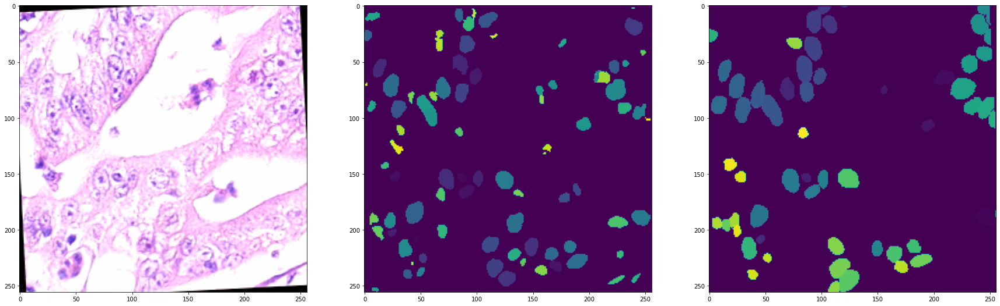

loss 0.7334973812103271
loss 0.6460371613502502
loss 0.6314845085144043
loss 0.7073228359222412
loss 0.707525372505188
loss 0.7347458600997925
loss 0.36509454250335693
loss 0.3487429618835449
loss 0.3724338710308075
loss 0.6920127868652344
loss 0.6542673110961914
loss 0.6032390594482422
loss 0.5935924053192139
loss 0.47249171137809753
loss 0.7585715651512146
loss 0.7213594913482666
loss 0.8065780401229858
loss 0.6733415126800537
loss 0.7628347873687744
loss 0.6315641403198242
loss 0.69163978099823
loss 0.6637344360351562
loss 0.6268291473388672
loss 0.6046501398086548
loss 0.6908828020095825
loss 0.6990880966186523
loss 0.7114769816398621
loss 0.7271188497543335
loss 0.7237972021102905
loss 0.6791341304779053
loss 0.6416134834289551
loss 0.6388235092163086
loss 0.7751884460449219
loss 0.7370214462280273
loss 0.732073187828064
loss 0.76368248462677
loss 0.7171614170074463
loss 0.6634190082550049
loss 0.3003365695476532
loss 0.635515570640564
loss 0.7409263849258423
loss 0.84068715572357

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


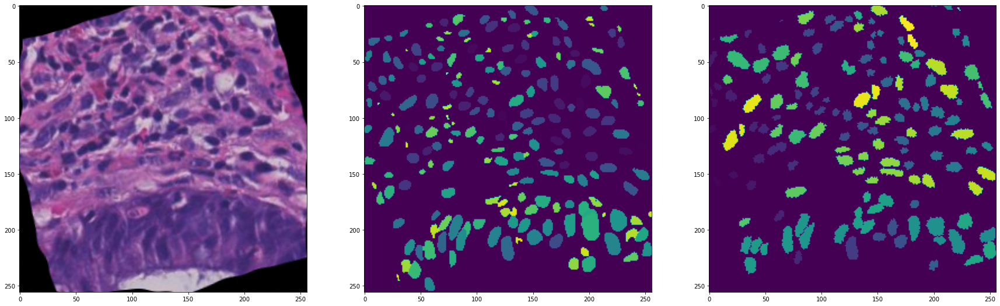

loss 0.6529351472854614
loss 0.7718122601509094
loss 0.719343364238739
loss 0.80158531665802
loss 0.6214499473571777
loss 0.6898934841156006
loss 0.41416382789611816
loss 0.7432528734207153
loss 0.7034213542938232
loss 0.7450376749038696
loss 0.6854708194732666
loss 0.7200025320053101
loss 0.7044122219085693
loss 0.7050118446350098
loss 0.689769983291626
loss 0.5879342555999756
loss 0.6424950361251831
loss 0.6739717721939087
loss 0.7612370252609253
loss 0.42092737555503845
loss 0.6674420833587646
loss 0.7732930183410645
loss 0.649554431438446
loss 0.7020149827003479
loss 0.7222335338592529
loss 0.37469932436943054
loss 0.7202713489532471
loss 0.7991831302642822
loss 0.7226847410202026
loss 0.7034609317779541
loss 0.6788797378540039
loss 0.6424387693405151
loss 0.6493082046508789
loss 0.7055323123931885
loss 0.717281699180603
loss 0.6219785213470459
loss 0.7821076512336731
loss 0.7403128743171692
loss 0.7160009145736694
loss 0.7176288366317749
loss 0.6572873592376709
loss 0.691001653671

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


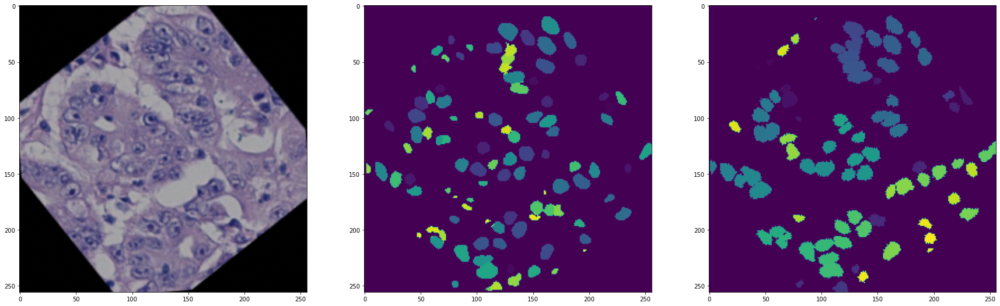

Validation loss:  0.6315224766731262
loss 0.790286660194397
loss 0.6748325824737549
loss 0.769765317440033
loss 0.7789953947067261
loss 0.7826545238494873
loss 0.6979520916938782
loss 0.689075231552124
loss 0.6966242790222168
loss 0.7389199733734131
loss 0.7624307870864868
loss 0.6395337581634521
loss 0.7560387849807739
loss 0.7798174619674683
loss 0.71807861328125
loss 0.7928991317749023
loss 0.6443533897399902
loss 0.61846923828125
loss 0.6713234186172485
loss 0.740141749382019
loss 0.6915558576583862
loss 0.6383655071258545
loss 0.7227200269699097
loss 0.7610148191452026
loss 0.7023728489875793
loss 0.6649850606918335
loss 0.7088449001312256
loss 0.696742057800293
loss 0.7823820114135742
loss 0.6927453875541687
loss 0.6293619871139526
loss 0.7651609182357788
loss 0.639313817024231
loss 0.6395307779312134
loss 0.3886999487876892
loss 0.7390045523643494
loss 0.5919502973556519
loss 0.680954098701477
loss 0.7252541780471802
loss 0.7114564180374146
loss 0.6616607904434204
loss 0.7483273

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


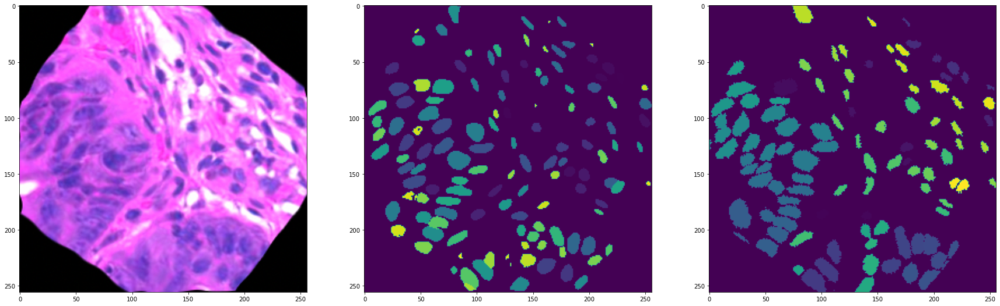

loss 0.7893784046173096
loss 0.6464903354644775
loss 0.672754168510437
loss 0.6611891984939575
loss 0.6885604858398438
loss 0.6319657564163208
loss 0.7374684810638428
loss 0.8359094858169556
loss 0.7940859794616699
loss 0.7655386924743652
loss 0.6952643394470215
loss 0.6697613000869751
loss 0.6032419204711914
loss 0.5875818729400635
loss 0.690942645072937
loss 0.6306393146514893
loss 0.657843828201294
loss 0.6652150750160217
loss 0.6712691783905029
loss 0.7388598322868347
loss 0.6527536511421204
loss 0.7155991792678833
loss 0.5762273073196411
loss 0.7205134630203247
loss 0.6867535710334778
loss 0.600684404373169
loss 0.7761372327804565
loss 0.7355861067771912
loss 0.6896028518676758
loss 0.6390645503997803
loss 0.7363051772117615
loss 0.6214349269866943
loss 0.3440667390823364
loss 0.7256544828414917
loss 0.7082653045654297
loss 0.7613921165466309
loss 0.6354936957359314
loss 0.7376765012741089
loss 0.7462114095687866
loss 0.3919200599193573
loss 0.7652710676193237
loss 0.5752522349357

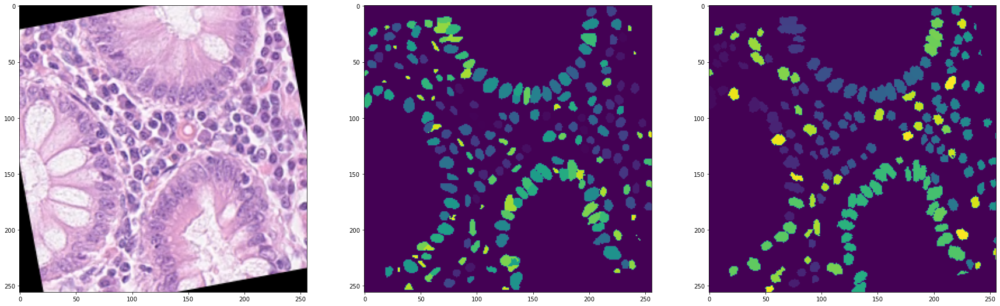

loss 0.7027926445007324
loss 0.7326267957687378
loss 0.6710616946220398
loss 0.7466317415237427
loss 0.718267560005188
loss 0.7462729811668396
loss 0.6356245875358582
loss 0.7640196084976196
loss 0.7168801426887512
loss 0.6629766225814819
loss 0.7256256341934204
loss 0.6936485767364502
loss 0.723589301109314
loss 0.6799708604812622
loss 0.3751775026321411
loss 0.7658704519271851
loss 0.7034721374511719
loss 0.7306261658668518
loss 0.4041830897331238
loss 0.7644072771072388
loss 0.7442327737808228
loss 0.6658757925033569
loss 0.6270749568939209
loss 0.5601715445518494
loss 0.6470975875854492
loss 0.689481794834137
loss 0.661792516708374
loss 0.7321600914001465
loss 0.7302280068397522
loss 0.7382588386535645
loss 0.6918739676475525
loss 0.685979962348938
loss 0.6668795943260193
loss 0.8105583190917969
loss 0.7341156005859375
loss 0.7257351279258728
loss 0.7385846376419067
loss 0.7448055744171143
loss 0.841333270072937
loss 0.6988857388496399
loss 0.7161153554916382
loss 0.733556747436523

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


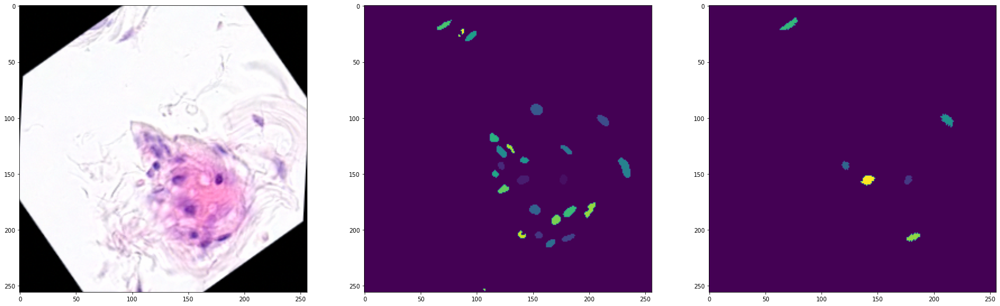

loss 0.6972597241401672
loss 0.7642430067062378
loss 0.7933145761489868
loss 0.7118315100669861
loss 0.6511611938476562
loss 0.7033318281173706
loss 0.7089961767196655
loss 0.6640058755874634
loss 0.7628142833709717
loss 0.6709507703781128
loss 0.42925384640693665
loss 0.5900416374206543
loss 0.7600234746932983
loss 0.3193707764148712
loss 0.6567364931106567
loss 0.7077822089195251
loss 0.7658880949020386
loss 0.7534478902816772
loss 0.7645024657249451
loss 0.7627420425415039
loss 0.6902279853820801
loss 0.7235987186431885
loss 0.6645451188087463
loss 0.706528902053833
loss 0.7176467776298523
loss 0.7411531209945679
loss 0.7455856204032898
loss 0.6385754346847534
loss 0.6733512878417969
loss 0.617648720741272
loss 0.6254628896713257
loss 0.6645721793174744
loss 0.7127927541732788
loss 0.6751694679260254
loss 0.7977319955825806
loss 0.7589404582977295
loss 0.7123675346374512
loss 0.7185577154159546
loss 0.8407210111618042
loss 0.7515666484832764
loss 0.6725023984909058
loss 0.7075062990

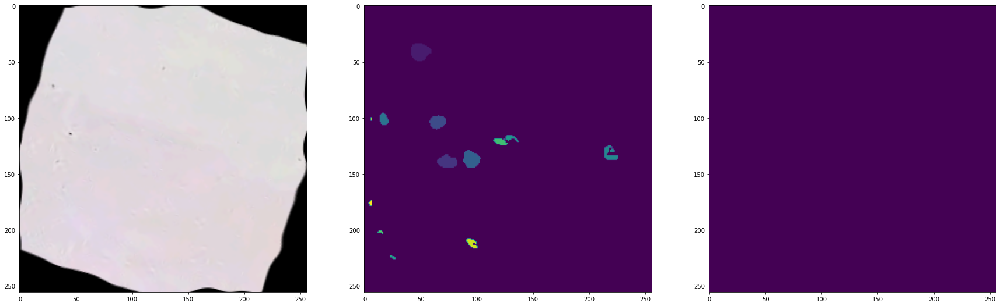

loss 0.7301627397537231
loss 0.7368196249008179
loss 0.6913813352584839
loss 0.6721819639205933
loss 0.7213172912597656
loss 0.7271600365638733
loss 0.6192046403884888
loss 0.68257737159729
loss 0.7298206090927124
loss 0.6417710185050964
loss 0.7316564321517944
loss 0.757980227470398
loss 0.7124193906784058
loss 0.6668679714202881
loss 0.6913557052612305
loss 0.6803348064422607
loss 0.6995388865470886
loss 0.6987483501434326
loss 0.6632325649261475
loss 0.6883352994918823
loss 0.6723355054855347
loss 0.6564285755157471
loss 0.6945825219154358
loss 0.6610062718391418
loss 0.7280578017234802
loss 0.6945505142211914
loss 0.6610563397407532
loss 0.7505130171775818
loss 0.7162864208221436
loss 0.7006277441978455
loss 0.7544698715209961
loss 0.6351265907287598
loss 0.7544416189193726
loss 0.7483088970184326
loss 0.7030289173126221
loss 0.7811388373374939
loss 0.6642544865608215
loss 0.7132712602615356
loss 0.6815382242202759
loss 0.7270030975341797
loss 0.789332389831543
loss 0.6584388017654

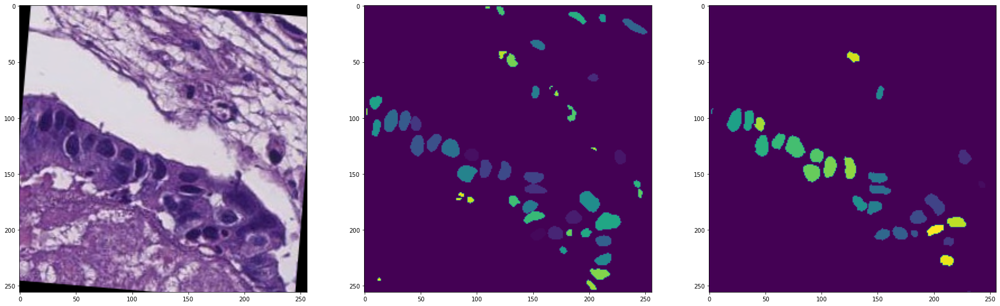

Validation loss:  0.6915228366851807
loss 0.7439111471176147
loss 0.7784851789474487
loss 0.4040844440460205
loss 0.690690279006958
loss 0.634679913520813
loss 0.6895874738693237
loss 0.7594286203384399
loss 0.6904802322387695
loss 0.7850285172462463
loss 0.6629300117492676
loss 0.6998511552810669
loss 0.781752347946167
loss 0.7101761698722839
loss 0.7325308322906494
loss 0.5985997319221497
loss 0.7157703042030334
loss 0.8053019046783447
loss 0.7050410509109497
loss 0.5915578603744507
loss 0.661988377571106
loss 0.5950958132743835
loss 0.6518896818161011
loss 0.6710209846496582
loss 0.6931711435317993
loss 0.7153383493423462
loss 0.6160989999771118
loss 0.7084290981292725
loss 0.7377045750617981
loss 0.6350449919700623
loss 1.0047872066497803
loss 0.7315760254859924
loss 0.7162386775016785
loss 0.6993036270141602
loss 0.6916333436965942
loss 0.6690270900726318
loss 0.6965621113777161
loss 0.6963402032852173
loss 0.7029567956924438
loss 0.6489543914794922
loss 0.706000566482544
loss 0.7

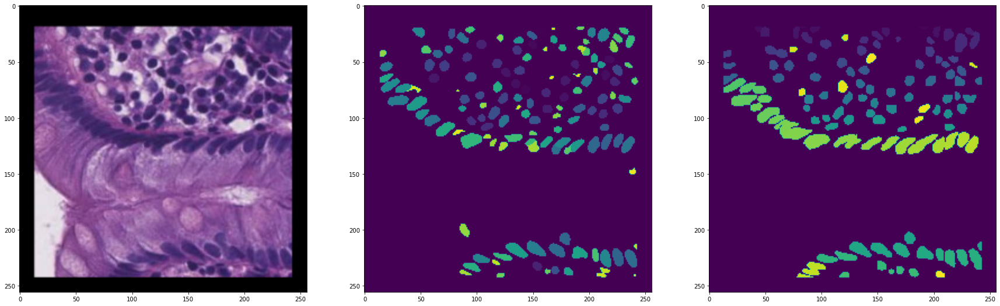

loss 0.7363286018371582
loss 0.6415894031524658
loss 0.6684613227844238
loss 0.6317864656448364
loss 0.69703608751297
loss 0.5609721541404724
loss 0.8468872904777527
loss 0.6775842905044556
loss 0.8045238256454468
loss 0.6869055032730103
loss 0.7114410996437073
loss 0.7108249664306641
loss 0.8157387971878052
loss 0.686874508857727
loss 0.677009105682373
loss 0.8217558860778809
loss 0.7052804231643677
loss 0.744225263595581
loss 0.8020427227020264
loss 0.6788421273231506
loss 0.7284915447235107
loss 0.3625870645046234
loss 0.723639965057373
loss 0.7782633304595947
loss 0.6979116797447205
loss 1.0268430709838867
loss 0.6249433159828186
loss 0.7123286724090576
loss 0.8443236351013184
loss 0.33446770906448364
loss 0.7701689600944519
loss 0.718077540397644
loss 0.6654155254364014
loss 0.6285400390625
loss 0.6625849604606628
loss 0.6793224811553955
loss 0.6692909598350525
loss 0.6804428100585938
loss 0.7073410749435425
loss 0.6844189167022705
loss 0.7648758888244629
loss 0.5822975039482117
l

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


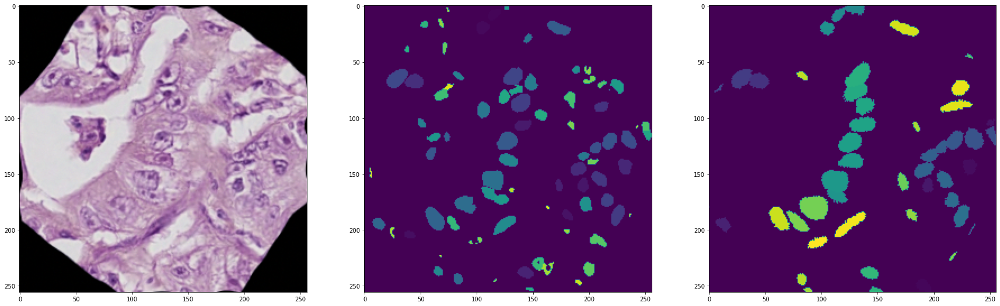

loss 0.7119849920272827
loss 0.6431912183761597
loss 0.6757640838623047
loss 0.7900859117507935
loss 0.747613251209259
loss 0.6670651435852051
loss 0.6176089644432068
loss 0.8261516690254211
loss 0.671613335609436
loss 0.6569685935974121
loss 0.6837407350540161
loss 0.7720701694488525
loss 0.7458215951919556
loss 0.6441309452056885
loss 0.7041462659835815
loss 0.7571200132369995
loss 0.8274758458137512
loss 0.72148597240448
loss 0.8991426825523376
loss 0.7373404502868652
loss 0.7026975750923157
loss 0.7907310724258423
loss 0.8332363367080688
loss 0.6623594760894775
loss 0.7107307314872742
loss 0.7259412407875061
loss 0.7188887596130371
loss 0.3707020878791809
loss 0.666773796081543
loss 0.7617112398147583
loss 0.6695821285247803
loss 0.7565167546272278
loss 0.5451611876487732
loss 0.7525530457496643
loss 0.6834802627563477
loss 0.6870208978652954
loss 0.6512154340744019
loss 0.7893062829971313
loss 0.6519460082054138
loss 0.6239055395126343
loss 0.6152273416519165
loss 0.34921389818191

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


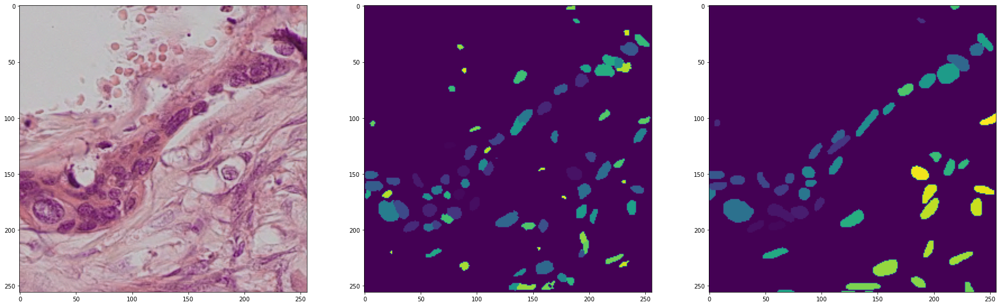

loss 0.7055742144584656
loss 0.6266613006591797
loss 0.3508639335632324
loss 0.6946423053741455
loss 0.7123546600341797
loss 0.7822036743164062
loss 0.7614495754241943
loss 0.6045429110527039
loss 0.5858554840087891
loss 0.7160204648971558
loss 0.8109023571014404
loss 0.706412672996521
loss 0.675290048122406
loss 0.7210848331451416
loss 0.7375006675720215
loss 0.7168412804603577
loss 0.6987301707267761
loss 0.35945558547973633
loss 0.7589972019195557
loss 0.6975055932998657
loss 0.7081754207611084
loss 0.7515710592269897
loss 0.6915819644927979
loss 0.7605600357055664
loss 0.6858620643615723
loss 0.6876575946807861
loss 0.6443338394165039
loss 0.7528625726699829
loss 0.6201344728469849
loss 0.7259892225265503
loss 0.5072238445281982
loss 0.7061734199523926
loss 0.6861069798469543
loss 0.7481595277786255
loss 0.7881585359573364
loss 0.7739630341529846
loss 0.6567447185516357
loss 0.6549501419067383
loss 0.6860734224319458
loss 0.6874669790267944
loss 0.7052032351493835
loss 0.7040253877

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


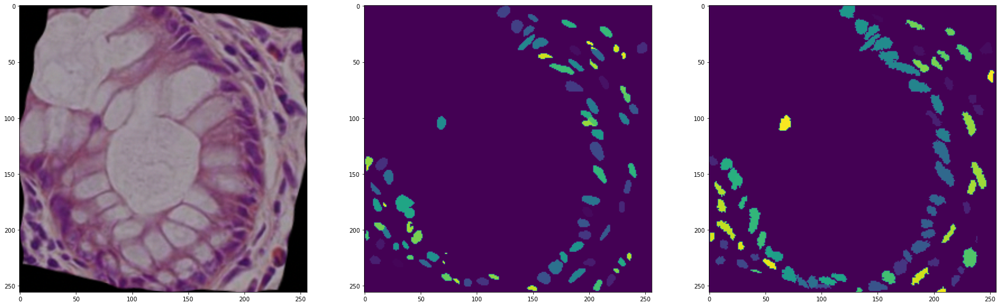

loss 0.6669907569885254
loss 0.677318274974823
loss 0.6518077850341797
loss 0.7604296803474426
loss 0.7270317077636719
loss 0.7412182092666626
loss 0.7077105045318604
loss 0.6327123641967773
loss 0.7783114314079285
loss 0.7169061899185181
loss 0.7064724564552307
loss 0.6258987784385681
loss 0.6565338373184204
loss 0.6607260704040527
loss 0.7002768516540527
loss 0.7814052104949951
loss 0.6927345991134644
loss 0.6250565052032471
loss 0.5321919918060303
loss 0.7013927698135376
loss 0.649649441242218
loss 0.7258457541465759
loss 0.3194507658481598
loss 0.6416371464729309
loss 0.6041709184646606
loss 0.6611542701721191
loss 0.6990292072296143
loss 0.7274065017700195
loss 0.6573096513748169
loss 0.787272036075592
loss 0.7144496440887451
loss 0.7137901782989502
loss 0.6864821314811707
loss 0.789265513420105
loss 0.6323617696762085
loss 0.5914125442504883
loss 0.7206680774688721
loss 0.6583043336868286
loss 0.7255369424819946
loss 0.7411447167396545
loss 0.7204813957214355
loss 0.7475533485412

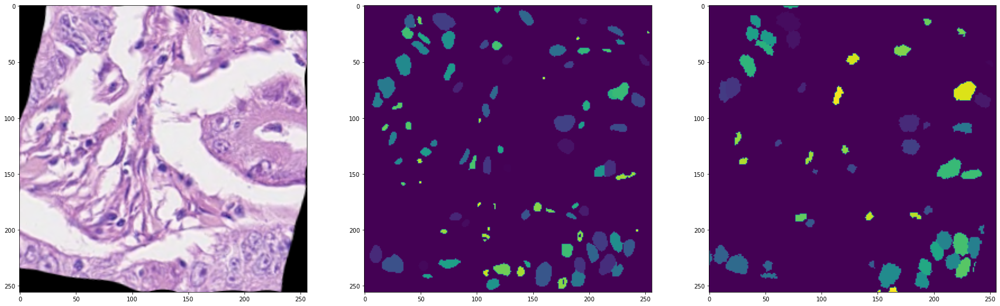

Validation loss:  0.7466459274291992
loss 0.7162543535232544
loss 0.6780241131782532
loss 0.6499484777450562
loss 0.017243804410099983
loss 0.6830316185951233
loss 0.669840931892395
loss 0.6966308951377869
loss 0.7641638517379761
loss 0.6804616451263428
loss 0.6812217235565186
loss 0.7269039154052734
loss 0.6686780452728271
loss 0.6945850253105164
loss 0.5977482795715332
loss 0.6297973394393921
loss 0.7442201972007751
loss 0.7097065448760986
loss 0.6495139598846436
loss 0.6229212880134583
loss 0.5969245433807373
loss 0.6115413308143616
loss 0.7226630449295044
loss 0.7234184741973877
loss 0.7058058977127075
loss 0.6784229874610901
loss 0.7328969836235046
loss 0.8203117847442627
loss 0.7333474159240723
loss 0.4921839237213135
loss 0.39644327759742737
loss 0.5628563165664673
loss 0.6704729795455933
loss 0.6734362840652466
loss 0.6667097806930542
loss 0.7175554037094116
loss 0.6353889107704163
loss 0.6785746812820435
loss 0.7616363167762756
loss 0.6721258163452148
loss 0.6667283177375793
l

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


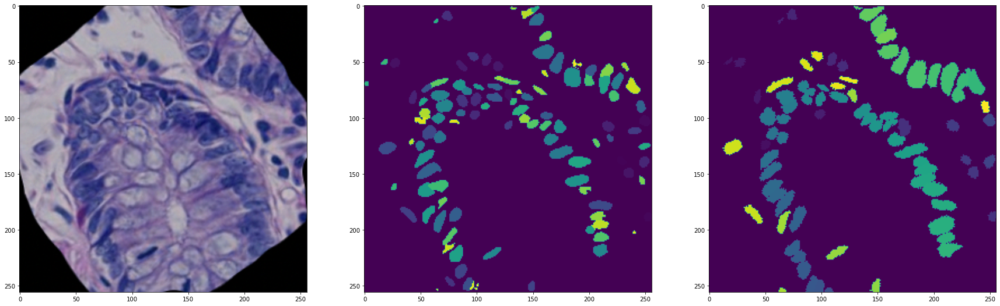

loss 0.7249060869216919
loss 0.721174955368042
loss 0.6779733896255493
loss 0.6820039749145508
loss 0.6283724904060364
loss 0.6880213022232056
loss 0.7227556705474854
loss 0.6331983804702759
loss 0.7120504379272461
loss 0.754840612411499
loss 0.6959967613220215
loss 0.7231764197349548
loss 0.727929949760437
loss 0.6515886783599854
loss 0.6970365047454834
loss 0.7375715970993042
loss 0.7850521802902222
loss 0.6169358491897583
loss 0.7151374816894531
loss 0.646001935005188
loss 0.647497296333313
loss 0.6846905946731567
loss 0.6842919588088989
loss 0.6694194078445435
loss 0.6486343145370483
loss 0.7014917135238647
loss 0.7895164489746094
loss 0.706841230392456
loss 0.6478173732757568
loss 0.6635496616363525
loss 0.6564352512359619
loss 0.7059489488601685
loss 0.6695308685302734
loss 0.6787148714065552
loss 0.749555230140686
loss 0.756378710269928
loss 0.6989938020706177
loss 0.7009749412536621
loss 0.6345677375793457
loss 0.6349823474884033
loss 0.6853957176208496
loss 0.676167905330658
l

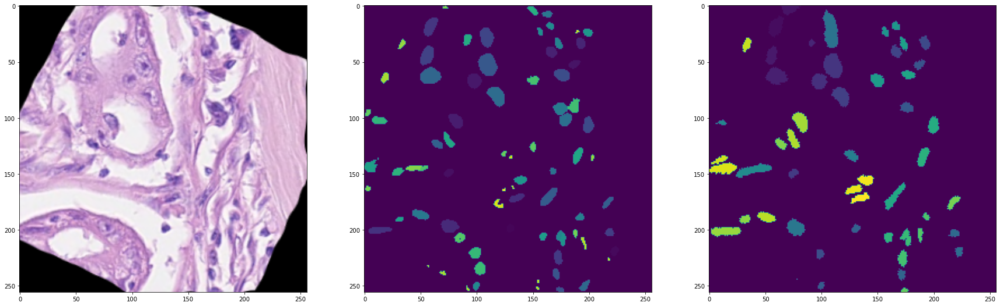

loss 0.37414467334747314
loss 0.6273231506347656
loss 0.786978542804718
loss 0.6719203591346741
loss 0.719616711139679
loss 0.5616135597229004
loss 0.6781772375106812
loss 0.6368445158004761
loss 0.673361599445343
loss 0.699511706829071
loss 0.5955119132995605
loss 0.636416494846344
loss 0.7240135669708252
loss 0.5589098930358887
loss 0.8029054403305054
loss 0.6346602439880371
loss 0.6855010390281677
loss 0.7461262941360474
loss 0.7109920978546143
loss 0.7591603994369507
loss 0.674628734588623
loss 1.519205093383789
loss 0.765758752822876
loss 0.6631441116333008
loss 0.7333099842071533
loss 0.7523605823516846
loss 0.7379252910614014
loss 0.8045659065246582
loss 0.6933665871620178
loss 0.6957626342773438
loss 0.6585724353790283
loss 0.7185378074645996
loss 0.7213493585586548
loss 0.7152880430221558
loss 0.6527273654937744
loss 0.6845548152923584
loss 0.7268396615982056
loss 0.7243351340293884
loss 0.739154577255249
loss 0.816368579864502
loss 0.7983027100563049
loss 0.7968295216560364
l

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


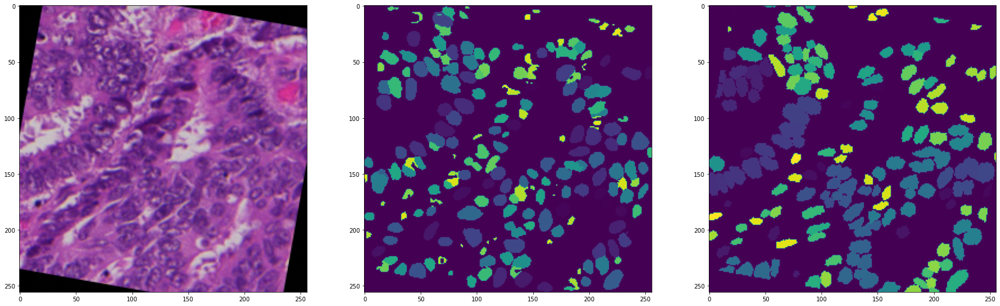

loss 0.7051300406455994
loss 0.7164860367774963
loss 0.7396752238273621
loss 0.6988234519958496
loss 0.7606160044670105
loss 0.6896897554397583
loss 0.6267762780189514
loss 0.6541332006454468
loss 0.6426950693130493
loss 0.7031018733978271
loss 0.6866759061813354
loss 0.6245739459991455
loss 0.66077721118927
loss 0.6607757806777954
loss 0.5999722480773926
loss 0.727009117603302
loss 0.5864379405975342
loss 0.47370702028274536
loss 0.7169907093048096
loss 0.7095308899879456
loss 0.6885613799095154
loss 0.6441155672073364
loss 0.6370044946670532
loss 0.6787962913513184
loss 0.696511447429657
loss 0.6337108612060547
loss 0.6835437417030334
loss 0.6126455068588257
loss 0.5934246182441711
loss 0.7319642305374146
loss 0.3375704288482666
loss 0.7231766581535339
loss 0.3721503019332886
loss 0.6500240564346313
loss 0.6906681060791016
loss 0.7523126006126404
loss 0.7956598997116089
loss 0.6747175455093384
loss 0.7500016689300537
loss 0.36134615540504456
loss 0.5821924209594727
loss 0.36389419436

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


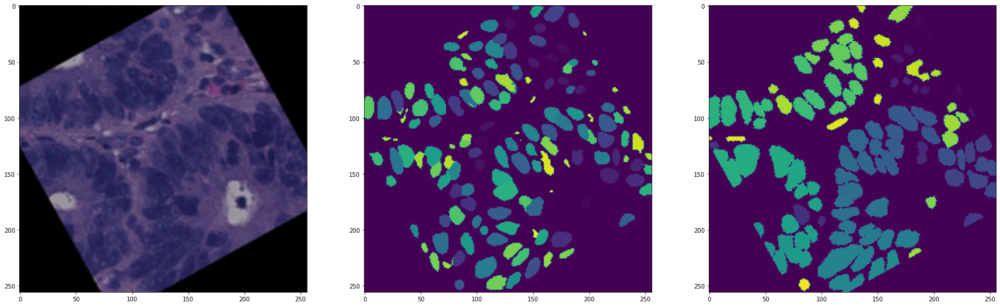

loss 0.7712323665618896
loss 0.6640112996101379
loss 0.9862303733825684
loss 0.6034358739852905
loss 0.9143104553222656
loss 0.7358326315879822
loss 0.7245604991912842
loss 0.6502621173858643
loss 0.8180900812149048
loss 0.6852293014526367
loss 0.6570600271224976
loss 0.7264701128005981
loss 0.683875560760498
loss 0.7031063437461853
loss 0.44525301456451416
loss 0.7709977626800537
loss 0.37682434916496277
loss 0.7161853313446045
loss 0.7121766209602356
loss 0.7152602672576904
loss 0.6084545254707336
loss 0.7090582251548767
loss 0.7002593278884888
loss 0.8283467292785645
loss 0.6739282608032227
loss 0.41238757967948914
loss 0.6482570767402649
loss 0.6740235090255737
loss 0.7108769416809082
loss 0.7655214667320251
loss 0.6755317449569702
loss 0.7152057886123657
loss 0.7163503170013428
loss 0.6706247329711914
loss 0.7486149668693542
loss 0.7810171842575073
loss 0.7372845411300659
loss 0.737441897392273
loss 0.7530860900878906
loss 0.6836021542549133
loss 0.7693670988082886
loss 0.72155463

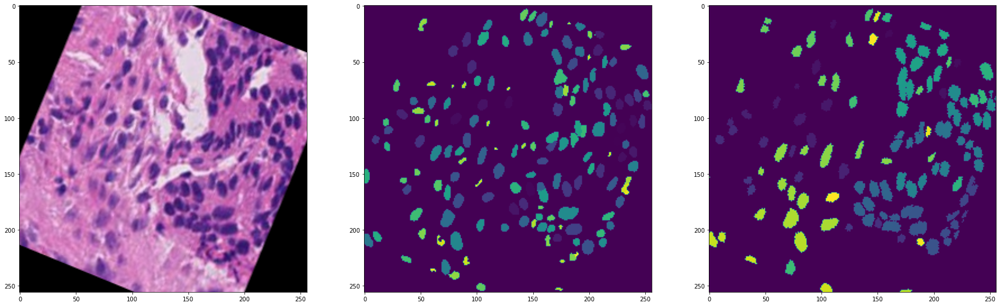

Validation loss:  0.7188425660133362
loss 0.39224886894226074
loss 0.8085225224494934
loss 0.5976668000221252
loss 0.667619526386261
loss 0.6855844855308533
loss 0.6990465521812439
loss 0.7091607451438904
loss 0.7497240900993347
loss 0.7010382413864136
loss 0.646767795085907
loss 0.6142845153808594
loss 0.3346620798110962
loss 0.6628453731536865
loss 0.7046135663986206
loss 0.6654142141342163
loss 0.738243579864502
loss 0.6918798089027405
loss 0.6907589435577393
loss 0.6213163733482361
loss 0.6142817735671997
loss 0.7260331511497498
loss 0.6824865937232971
loss 0.6916693449020386
loss 0.7058151364326477
loss 0.6963311433792114
loss 0.7193405628204346
loss 0.7202427387237549
loss 0.8301880955696106
loss 0.7959645390510559
loss 0.7402597665786743
loss 0.7595665454864502
loss 0.5932586193084717
loss 0.7348402738571167
loss 0.7392830848693848
loss 0.7310159802436829
loss 0.6940097808837891
loss 0.5852938890457153
loss 0.6201000213623047
loss 0.7685714960098267
loss 0.726081132888794
loss 0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


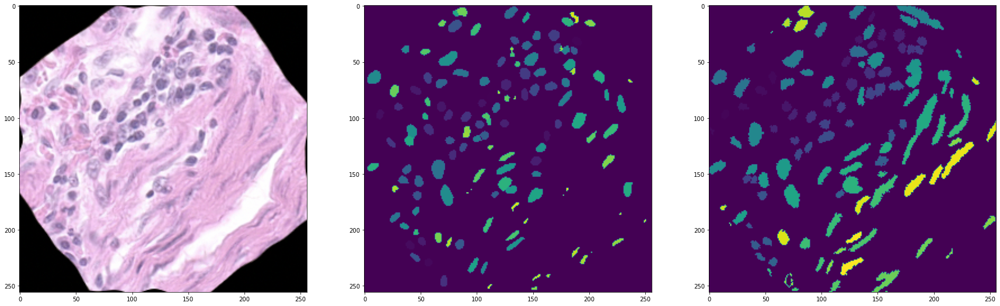

loss 0.3968043923377991
loss 0.700018584728241
loss 0.6030605435371399
loss 0.7343429327011108
loss 0.7387434244155884
loss 0.6829100847244263
loss 0.7644275426864624
loss 0.678778886795044
loss 0.6775263547897339
loss 0.7817471027374268
loss 0.6691426038742065
loss 0.7002710103988647
loss 0.687889575958252
loss 0.6811387538909912
loss 0.6739294528961182
loss 0.7420084476470947
loss 0.7277542352676392
loss 0.6733554601669312
loss 0.6466420888900757
loss 0.7453530430793762
loss 0.7238059043884277
loss 0.8072034120559692
loss 0.637540340423584
loss 0.6133660078048706
loss 0.7896561622619629
loss 0.6011624336242676
loss 0.7423839569091797
loss 0.606688380241394
loss 0.7024831771850586
loss 0.7836023569107056
loss 0.8363584280014038
loss 0.6670913696289062
loss 0.7830424308776855
loss 0.6711031198501587
loss 0.7230246067047119
loss 0.841446578502655
loss 0.5882116556167603
loss 0.46332451701164246
loss 0.6915414333343506
loss 0.7271885871887207
loss 0.6084150671958923
loss 0.72259688377380

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


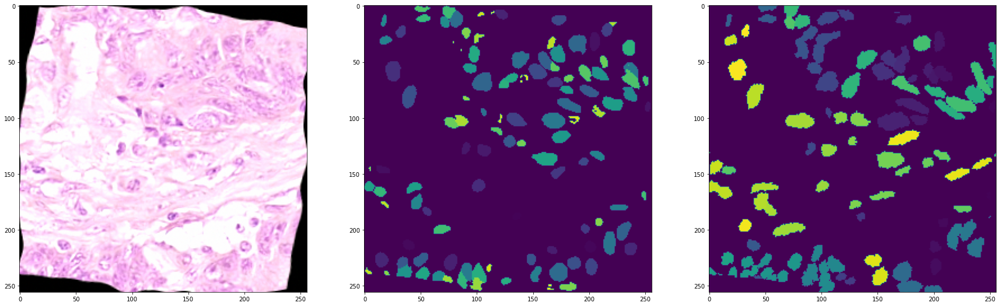

loss 0.6744351387023926
loss 0.6980926990509033
loss 0.44398242235183716
loss 0.6473217606544495
loss 0.637826681137085
loss 0.8826459050178528
loss 0.7322002649307251
loss 0.6954197883605957
loss 0.8221932649612427
loss 0.7418702244758606
loss 0.6743401288986206
loss 0.7436835765838623
loss 0.7504537105560303
loss 0.6665005087852478
loss 0.5817307233810425
loss 0.9388514757156372
loss 0.6395741701126099
loss 0.7535739541053772
loss 0.6518722772598267
loss 0.6536157131195068
loss 0.7493715286254883
loss 0.6360705494880676
loss 0.6968135833740234
loss 0.7225649356842041
loss 0.7411677241325378
loss 0.5791378021240234
loss 0.6857898235321045
loss 0.6954674124717712
loss 0.7034397721290588
loss 0.7270171046257019
loss 0.7288326621055603
loss 0.7297796010971069
loss 0.7129656076431274
loss 0.7276862859725952
loss 0.725319504737854
loss 0.7141612768173218
loss 0.7390076518058777
loss 0.6376520395278931
loss 0.7356753349304199
loss 0.6013344526290894
loss 0.9442020654678345
loss 0.6820029616

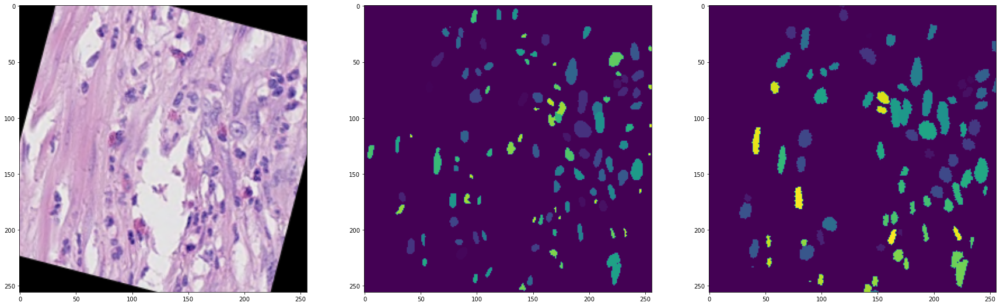

loss 0.7355947494506836
loss 0.6758729219436646
loss 0.7791109681129456
loss 0.5997231602668762
loss 0.7929872274398804
loss 0.759229302406311
loss 0.6011574864387512
loss 0.7079437971115112
loss 0.6661515235900879
loss 0.6477133631706238
loss 0.7162628173828125
loss 0.6964319944381714
loss 0.6666866540908813
loss 0.6466512680053711
loss 0.6074587106704712
loss 0.7079377770423889
loss 0.7843987941741943
loss 0.7654553055763245
loss 0.6374045610427856
loss 0.7176570892333984
loss 0.742682158946991
loss 0.6639295220375061
loss 0.6508021354675293
loss 0.7874747514724731
loss 0.7667868137359619
loss 0.7222754955291748
loss 0.6853777766227722
loss 0.725712776184082
loss 0.6232403516769409
loss 0.6853904724121094
loss 0.684637725353241
loss 0.6747372150421143
loss 0.7077910900115967
loss 0.6962972283363342
loss 1.1204912662506104
loss 0.6785975694656372
loss 0.6156536340713501
loss 0.7066861391067505
loss 0.7677631378173828
loss 0.6803399920463562
loss 0.7748825550079346
loss 0.7820156216621

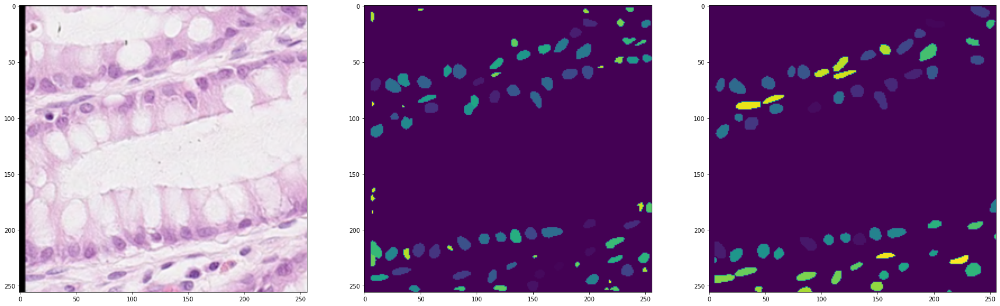

loss 0.709952712059021
loss 0.6824643611907959
loss 0.7276573181152344
loss 0.716651201248169
loss 0.6751468181610107
loss 0.6987743377685547
loss 0.6718165874481201
loss 0.8033575415611267
loss 0.6579530239105225
loss 0.5885833501815796
loss 0.749901294708252
loss 0.707597017288208
loss 0.7174546718597412
loss 0.730508029460907
loss 0.7727537155151367
loss 0.7229695320129395
loss 0.725123405456543
loss 0.6759021282196045
loss 0.6612033843994141
loss 0.31357911229133606
loss 0.736603856086731
loss 0.6535490155220032
loss 0.6153745651245117
loss 0.7181677222251892
loss 0.7688236832618713
loss 0.647013783454895
loss 0.7518761157989502
loss 0.7203754186630249
loss 0.6848822832107544
loss 0.6489802002906799
loss 0.6323782801628113
loss 0.7288029193878174
loss 0.6249635815620422
loss 0.7799841165542603
loss 0.6092055439949036
loss 0.747471272945404
loss 0.6429901123046875
loss 0.8105357885360718
loss 0.7378437519073486
loss 0.7091113328933716
loss 0.6895177364349365
loss 0.6235544085502625


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


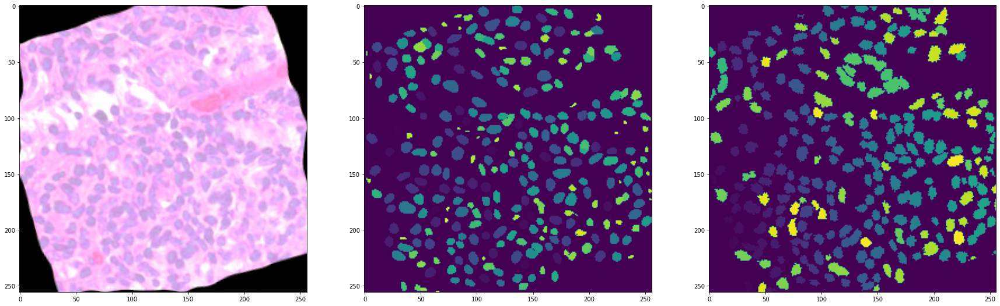

Validation loss:  0.627903163433075
loss 0.6654324531555176
loss 0.7427557706832886
loss 0.6748080253601074
loss 0.6374895572662354
loss 0.6693711876869202
loss 0.7299712896347046
loss 0.643078088760376
loss 0.6919293403625488
loss 0.7394799590110779
loss 0.7308824062347412
loss 0.3684331476688385
loss 0.6479213237762451
loss 0.7247508764266968
loss 0.6646338701248169
loss 0.6827065944671631
loss 0.6775444149971008
loss 0.6227772831916809
loss 0.6228584051132202
loss 0.7419365644454956
loss 0.6543163657188416
loss 0.7233377695083618
loss 0.5713212490081787
loss 0.6864283084869385
loss 0.7214473485946655
loss 0.7223687171936035
loss 0.702993631362915
loss 0.5841754674911499
loss 0.6852086782455444
loss 0.7776978611946106
loss 0.6218567490577698
loss 0.7005757093429565
loss 0.6516385674476624
loss 0.5882936716079712
loss 0.6656468510627747
loss 0.671840250492096
loss 0.6503528356552124
loss 0.707268476486206
loss 0.6775707006454468
loss 0.6672533750534058
loss 0.7300220727920532
loss 0.7

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


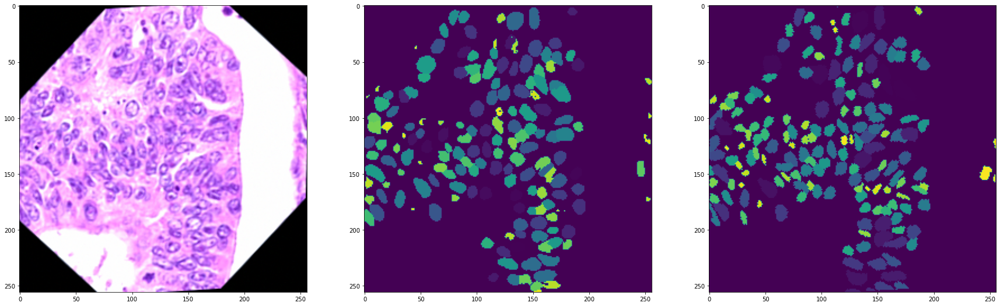

loss 0.3420374393463135
loss 0.32315874099731445
loss 0.6157410144805908
loss 0.6610677242279053
loss 0.6153428554534912
loss 0.7016698122024536
loss 0.7706964015960693
loss 0.6991387605667114
loss 0.6795216202735901
loss 0.6038260459899902
loss 0.6357505917549133
loss 0.715234637260437
loss 0.7703026533126831
loss 0.6916743516921997
loss 0.741133451461792
loss 0.6662023067474365
loss 0.7008230686187744
loss 0.7242470979690552
loss 0.6537061929702759
loss 0.6952603459358215
loss 0.6285302639007568
loss 0.31143906712532043
loss 0.7264636754989624
loss 0.743088960647583
loss 0.6245622634887695
loss 0.6463449597358704
loss 0.6587419509887695
loss 0.7498083710670471
loss 0.7210828065872192
loss 0.6392921209335327
loss 0.6081109046936035
loss 0.6436652541160583
loss 0.6569532155990601
loss 0.6677277684211731
loss 0.6580260992050171
loss 0.6776783466339111
loss 0.5857617259025574
loss 0.6754302382469177
loss 0.7088302373886108
loss 0.7025734186172485
loss 0.821097731590271
loss 0.65260267257

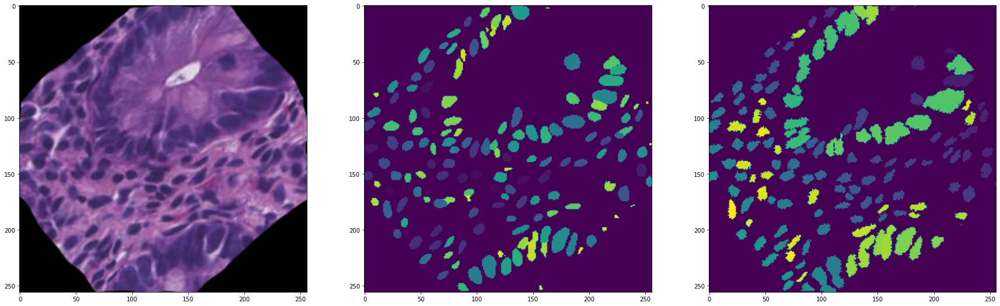

loss 0.7053454518318176
loss 0.683370053768158
loss 0.718599796295166
loss 0.7252339124679565
loss 0.6595803499221802
loss 0.7948172092437744
loss 0.7137370705604553
loss 0.7052780389785767
loss 0.7269514799118042
loss 0.7037338018417358
loss 0.628995954990387
loss 0.68987637758255
loss 0.6508326530456543
loss 0.6714109182357788
loss 0.6857151985168457
loss 0.7177891731262207
loss 0.7355160117149353
loss 0.7174577713012695
loss 0.6209441423416138
loss 0.755369246006012
loss 0.35988038778305054
loss 0.6146286725997925
loss 0.6646140217781067
loss 0.7029368877410889
loss 0.6833068132400513
loss 0.6841399669647217
loss 0.7687786817550659
loss 0.607430100440979
loss 0.703951358795166
loss 0.7093081474304199
loss 0.6565350294113159
loss 0.3870973289012909
loss 0.6968857049942017
loss 0.8347415328025818
loss 0.8869838714599609
loss 0.3976142108440399
loss 0.7829728126525879
loss 0.6852086186408997
loss 0.3830975592136383
loss 0.7021822929382324
loss 0.6221474409103394
loss 0.77294921875
loss

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


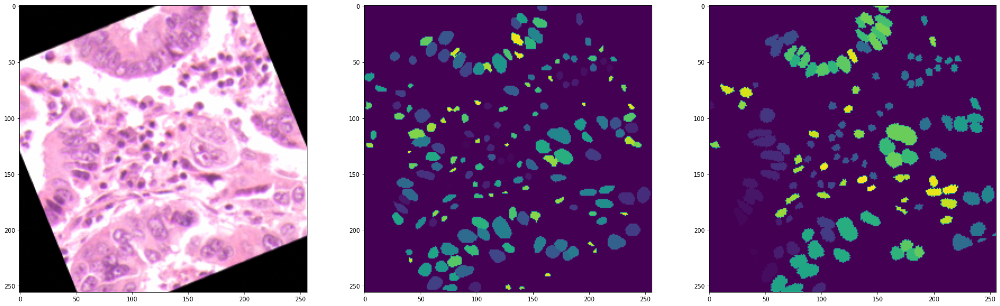

loss 0.6840769052505493
loss 0.7084163427352905
loss 0.6717309951782227
loss 0.695731520652771
loss 0.6823754906654358
loss 0.7292346954345703
loss 0.6910551190376282
loss 0.5441247224807739
loss 0.7813549041748047
loss 0.6613380908966064
loss 0.7032124400138855
loss 0.6248122453689575
loss 0.7198069095611572
loss 0.5924414396286011
loss 0.701494574546814
loss 0.6264326572418213
loss 0.688273549079895
loss 0.6392961740493774
loss 0.670697033405304
loss 0.6304441690444946
loss 0.6539429426193237
loss 0.7025623321533203
loss 0.37361079454421997
loss 0.6329326033592224
loss 0.8289660215377808
loss 0.718880832195282
loss 0.7596389055252075
loss 0.7148678302764893
loss 0.7030444145202637
loss 0.6531546711921692
loss 0.7594788670539856
loss 0.5434669256210327
loss 0.6608880758285522
loss 0.7051308751106262
loss 0.6644607782363892
loss 0.6829169392585754
loss 0.6911282539367676
loss 0.676925003528595
loss 0.683768630027771
loss 0.6468108892440796
loss 0.6893986463546753
loss 0.726970672607421

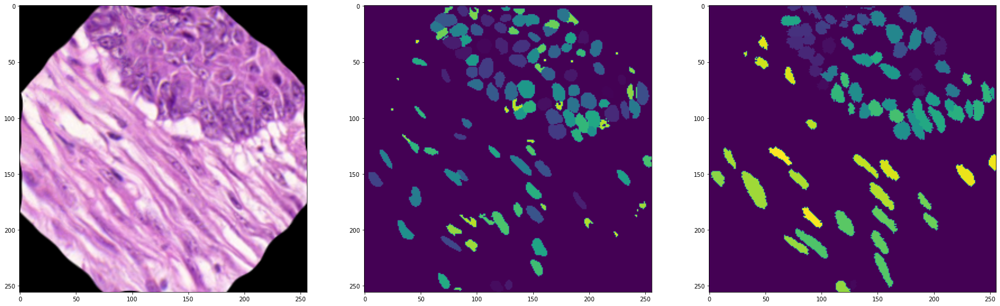

loss 0.7110534906387329
loss 0.7139466404914856
loss 0.7097463011741638
loss 0.6881970167160034
loss 0.7333177924156189
loss 0.6666712760925293
loss 0.6922429800033569
loss 0.7001760601997375
loss 0.7824417352676392
loss 0.6271624565124512
loss 0.7487924098968506
loss 0.8039429187774658
loss 0.7530204653739929
loss 0.6544814109802246
loss 0.7516894340515137
loss 0.3286466896533966
loss 0.6123890280723572
loss 0.7104340195655823
loss 0.5889951586723328
loss 0.8752627372741699
loss 0.7524617910385132
loss 0.6988275051116943
loss 0.6484121084213257
loss 0.7263393402099609
loss 0.7544766068458557
loss 0.7338167428970337
loss 0.7417304515838623
loss 0.7634463310241699
loss 0.6547667980194092
loss 0.7239483594894409
loss 0.7923251986503601
loss 0.8294979333877563
loss 0.6630331873893738
loss 0.7168332934379578
loss 0.6982477903366089
loss 0.7503474950790405
loss 0.7161397933959961
loss 0.7214972376823425
loss 0.6614334583282471
loss 0.7837058305740356
loss 0.6877674460411072
loss 0.700559854

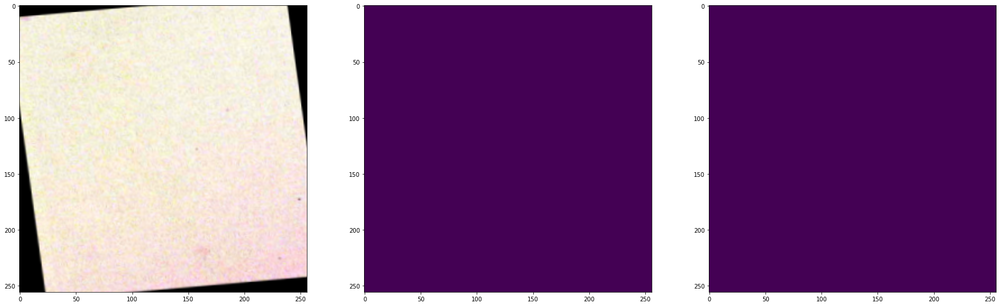

Validation loss:  0.7296234965324402
loss 0.6641806364059448
loss 0.30601146817207336
loss 0.6377455592155457
loss 0.635877251625061
loss 0.7461081743240356
loss 0.39562350511550903
loss 0.6303755044937134
loss 0.7062283754348755
loss 0.7039412260055542
loss 0.7531965970993042
loss 0.7445813417434692
loss 0.6238096952438354
loss 0.5974414348602295
loss 0.6341948509216309
loss 0.7415255308151245
loss 0.7417112588882446
loss 0.6172680258750916
loss 0.6173374056816101
loss 0.6687940359115601
loss 0.5432620644569397
loss 0.6963210701942444
loss 0.6052820682525635
loss 0.7706381678581238
loss 0.6955894231796265
loss 0.6495608687400818
loss 0.3922532796859741
loss 0.5783648490905762
loss 0.7134561538696289
loss 0.6914380788803101
loss 0.6977469325065613
loss 0.7086750268936157
loss 0.632697343826294
loss 0.7133020162582397
loss 0.720966637134552
loss 0.7232315540313721
loss 0.5621302723884583
loss 0.6893954873085022
loss 0.6346086859703064
loss 0.6777101159095764
loss 0.6628382205963135
loss

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


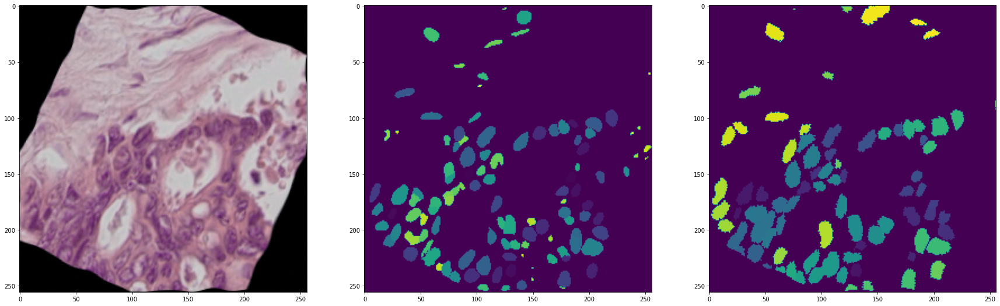

loss 0.729216456413269
loss 0.7261885404586792
loss 0.6830623149871826
loss 0.5947242975234985
loss 0.6486817598342896
loss 0.7787278890609741
loss 0.6746186017990112
loss 0.6240786910057068
loss 0.7806494832038879
loss 0.7331992983818054
loss 0.7003853917121887
loss 0.6528948545455933
loss 0.8011409044265747
loss 0.6303609609603882
loss 0.6824133396148682
loss 0.633331298828125
loss 0.6989214420318604
loss 0.6645742654800415
loss 0.672549307346344
loss 0.694446325302124
loss 0.6512500643730164
loss 0.7570822238922119
loss 0.7159557342529297
loss 0.8482667207717896
loss 0.6451437473297119
loss 0.5955286622047424
loss 0.7495336532592773
loss 0.7209283709526062
loss 0.790281355381012
loss 0.7755635380744934
loss 0.6382942199707031
loss 0.7494815587997437
loss 0.7198491096496582
loss 0.6629098653793335
loss 0.8061023950576782
loss 0.7486893534660339
loss 0.6324135661125183
loss 0.7460980415344238
loss 0.7584041357040405
loss 0.6076022386550903
loss 0.7532601952552795
loss 0.74241185188293

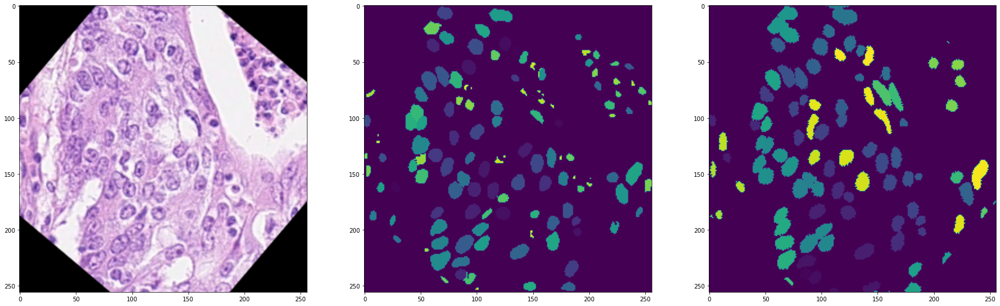

loss 0.6329978108406067
loss 0.7168939113616943
loss 0.7249137163162231
loss 0.6799740791320801
loss 0.7053241729736328
loss 0.6362147331237793
loss 0.5995438098907471
loss 0.6462493538856506
loss 0.6324782371520996
loss 0.7037245035171509
loss 0.7550692558288574
loss 0.33477315306663513
loss 0.7176625728607178
loss 0.6685574054718018
loss 0.6589745283126831
loss 0.7243403792381287
loss 0.6489740610122681
loss 0.6646682024002075
loss 0.663600742816925
loss 0.7444616556167603
loss 0.7192702293395996
loss 0.6621311902999878
loss 0.7106231451034546
loss 0.627494752407074
loss 0.8023762702941895
loss 0.7455976009368896
loss 0.5866672992706299
loss 0.6947357058525085
loss 0.6480534672737122
loss 1.0815678834915161
loss 0.7537437081336975
loss 0.7351022958755493
loss 0.690547525882721
loss 0.7158645391464233
loss 0.7479606866836548
loss 0.6353178024291992
loss 0.677148699760437
loss 0.6264473795890808
loss 0.70940101146698
loss 0.7315688133239746
loss 0.6981093287467957
loss 0.69277435541152

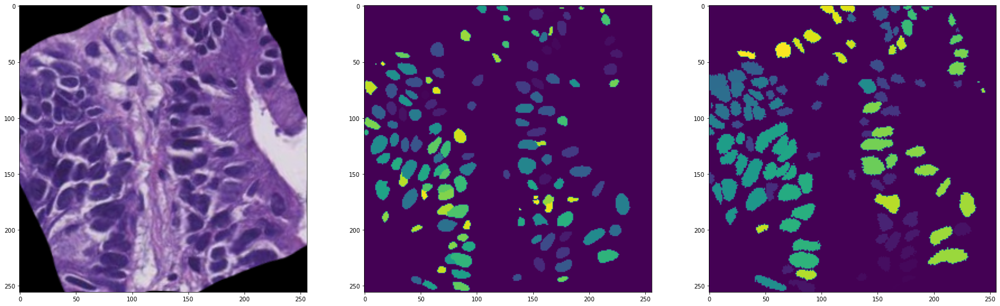

loss 0.8407135605812073
loss 0.5824298858642578
loss 0.7712582349777222
loss 0.7502325773239136
loss 0.8056912422180176
loss 0.35515347123146057
loss 0.6871116161346436
loss 0.7801811099052429
loss 0.714643120765686
loss 0.789641797542572
loss 0.6939805746078491
loss 0.8462033867835999
loss 0.7362867593765259
loss 0.6099044680595398
loss 0.6406997442245483
loss 0.7108331918716431
loss 0.7135307788848877
loss 0.699440598487854
loss 0.8108431696891785
loss 0.6994709372520447
loss 0.6015195846557617
loss 0.6897034049034119
loss 0.6804816126823425
loss 0.7329422235488892
loss 0.7117292881011963
loss 0.705357551574707
loss 0.6488714218139648
loss 0.6431695222854614
loss 0.300629198551178
loss 0.6483362317085266
loss 0.7127895355224609
loss 0.7514019012451172
loss 0.6894561052322388
loss 0.655280351638794
loss 0.6905471086502075
loss 0.6043205261230469
loss 0.6706472635269165
loss 0.43142613768577576
loss 0.7821574211120605
loss 0.7623612284660339
loss 0.6494612693786621
loss 0.6526632308959

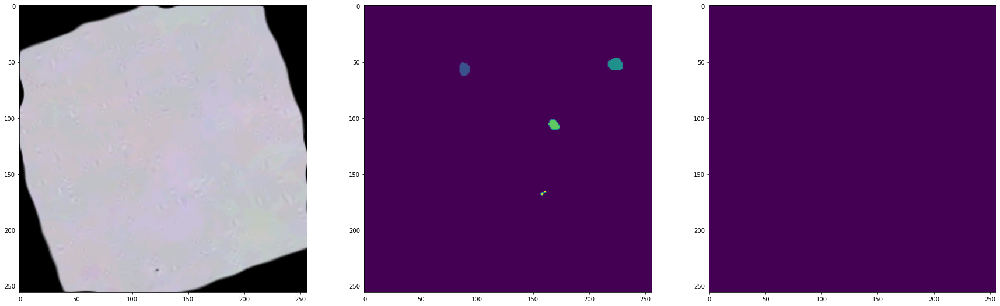

loss 0.7287466526031494
loss 0.7610465288162231
loss 0.7227339744567871
loss 0.6515979766845703
loss 0.7751798629760742
loss 0.6277173757553101
loss 0.64030921459198
loss 0.7242165803909302
loss 0.7140076756477356
loss 0.614448070526123
loss 0.7172917127609253
loss 0.675605058670044
loss 0.7167433500289917
loss 0.6913177967071533
loss 0.6912450194358826
loss 0.6827936768531799
loss 0.6314418315887451
loss 0.779694139957428
loss 0.6352330446243286
loss 0.6888949871063232
loss 0.7993944883346558
loss 0.729620099067688
loss 0.6373790502548218
loss 0.7454135417938232
loss 0.7549245357513428
loss 0.6255355477333069
loss 0.7784000635147095
loss 0.6259698271751404
loss 0.3771783113479614
loss 0.7492102384567261
loss 0.6507284045219421
loss 0.7751443982124329
loss 0.631377100944519
loss 0.6121152639389038
loss 0.7315986156463623
loss 0.7432057857513428
loss 0.42961838841438293
loss 0.7722941040992737
loss 0.6319364309310913
loss 0.7026492357254028
loss 0.42292237281799316
loss 0.73496890068054

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


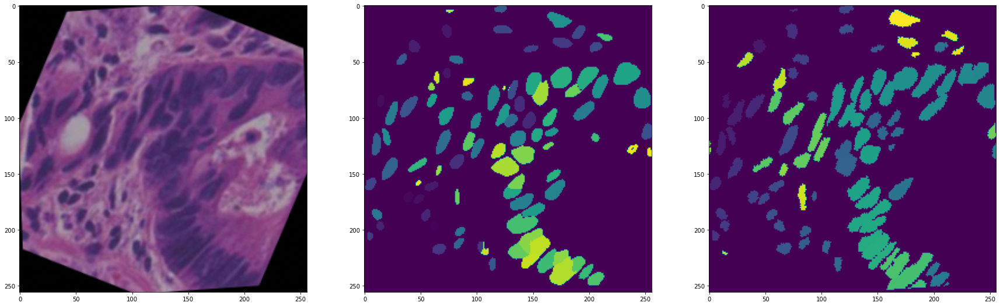

Validation loss:  0.051120251417160034
Save best model
Save snapshot
Save training snapshot
loss 0.602190375328064
loss 0.6880216598510742
loss 0.7613978385925293
loss 0.681881308555603
loss 0.6669027209281921
loss 0.6441906690597534
loss 0.6884679198265076
loss 0.6749351024627686
loss 0.7153949737548828
loss 0.6654447317123413
loss 0.6247051358222961
loss 0.6206689476966858
loss 0.6991750001907349
loss 0.7503169775009155
loss 0.7706224918365479
loss 0.7630305290222168
loss 0.8115569353103638
loss 0.7320579290390015
loss 0.7147747278213501
loss 0.7703296542167664
loss 0.685698390007019
loss 0.3500280976295471
loss 0.6401557922363281
loss 0.6614512205123901
loss 0.6948469281196594
loss 0.7889758348464966
loss 0.6864253282546997
loss 0.8111326694488525
loss 0.7680729627609253
loss 0.7096349000930786
loss 0.5598545074462891
loss 0.6513907313346863
loss 0.65435391664505
loss 0.6492763757705688
loss 0.6837954521179199
loss 0.7963007092475891
loss 0.6443187594413757
loss 0.7325265407562256
l

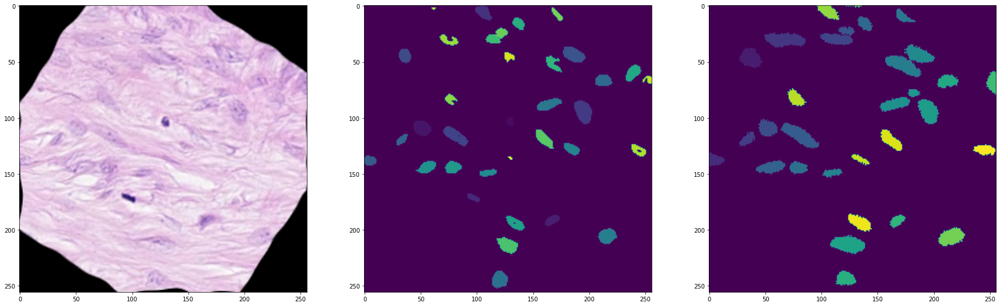

loss 0.6686614155769348
loss 0.5932922959327698
loss 0.7416451573371887
loss 0.7447918653488159
loss 0.6981737613677979
loss 0.36384934186935425
loss 0.7328959703445435
loss 0.4010801911354065
loss 0.6892545223236084
loss 0.863337516784668
loss 0.6794805526733398
loss 0.7899070382118225
loss 0.7038109302520752
loss 0.6718852519989014
loss 0.5706163048744202
loss 0.5867199897766113
loss 0.6781010031700134
loss 0.762580156326294
loss 0.6690523028373718
loss 0.6728900671005249
loss 0.2858128845691681
loss 0.7338047623634338
loss 0.40934187173843384
loss 0.7114346027374268
loss 0.7952393293380737
loss 0.6604596376419067
loss 0.7288516759872437
loss 0.7221307754516602
loss 0.739892303943634
loss 0.7138016223907471
loss 0.6753784418106079
loss 0.7256273031234741
loss 0.6785929799079895
loss 0.7554891705513
loss 0.7676907777786255
loss 0.7181053161621094
loss 0.6858986616134644
loss 0.634017825126648
loss 0.8132027387619019
loss 0.7301986217498779
loss 0.396193265914917
loss 0.706617474555969

In [ ]:
supervised_training(params)

In [ ]:
from src.data_utils import center_crop

def instance_seg_train_step(model, raw, gt, fast_aug, color_aug_fn, inst_lossfn, writer, device, step, inst_model='cpv_3c'):
    raw = raw.to(device).float()
    raw = raw + raw.min() *-1
    raw /= raw.max()
    gt = gt.to(device).float()
    B,_,_,_ = raw.shape
    if inst_model == 'cpv_3c':
        gt_3c_list = []
    raw_list = []
    gt_inst_list = []
    for b in range(B):
        img = raw[b].permute(2,0,1).unsqueeze(0) # BHWC -> BCHW
        gt_ = gt[b].permute(2,0,1).unsqueeze(0) # BHW2 -> B2HW
        img_saug, gt_saug = fast_aug.forward_transform(img, gt_)
        #gt_inst = fix_mirror_padding(gt_saug[0,0].cpu().detach().numpy().astype(np.int32)) # slow af
        #gt_inst = torch.tensor(gt_inst, device=device).float().unsqueeze(0)
        gt_inst = gt_saug[:,0]
        if inst_model == 'cpv_3c':
            gt_3c = gt_saug[:,2]
            gt_3c_list.append(gt_3c)
        img_caug = color_aug_fn(img_saug)
        img_caug = img_saug
        raw_list.append(img_caug)
        gt_inst_list.append(gt_inst)
    img_caug = torch.cat(raw_list, axis = 0)
    gt_inst  = torch.cat(gt_inst_list, axis = 0)
    out_fast = model(img_caug)
    _,_,H,W = out_fast.shape
    gt_inst = center_crop(gt_inst.unsqueeze(0), H, W)
    pred_inst = out_fast
    if inst_model == 'cpv_3c':
        gt_3c = torch.cat(gt_3c_list, axis = 0)
        gt_3c = center_crop(gt_3c.unsqueeze(0), H, W)
        instance_loss = inst_lossfn(pred_inst, gt_inst, gt_3c)
    else:
        instance_loss = inst_lossfn(pred_inst, gt_inst.squeeze(0).float(), (gt_inst.squeeze(0)>0).float())
    writer.add_scalar('instance_loss', instance_loss, step)
    print('loss', instance_loss.item())
    return instance_loss, pred_inst,img_caug, gt_inst

In [ ]:
params['learning_rate']=1e-3
optimizer = torch.optim.AdamW(model.parameters(),
                              lr=params['learning_rate'],
                              weight_decay=params['weight_decay'])

def cvp_loss_fn(input, gt_inst):
    gt_inst = gt_inst.squeeze(0)
    gt_cpv_list = []
    for b in range(gt_inst.shape[0]):
        gt_cpv_list.append(make_cpvs(gt_inst.to(device)[b], device))
    gt_cpv = torch.cat(gt_cpv_list, axis=0)/256.0
    loss_cpv = F.mse_loss(input = input[:,:2].tanh(),target = gt_cpv.float())
    return loss_cpv

In [ ]:
from src.cluster import Cluster
import matplotlib.pyplot as plt
cl = Cluster(grid_y=256, grid_x=256, pixel_y=1, pixel_x=1)
step = 0
inst_loss_fn = SpatialEmbLoss(n_sigma=2, to_center=params['to_center'], foreground_weight=10, H=256,W=256).to(device)
while step < params['training_steps']:
    tmp_loader = iter(labeled_dataloader)
    for raw, gt in tmp_loader:
        step += 1

        optimizer.zero_grad()
        loss, pred_inst,img_caug, gt_inst = instance_seg_train_step(model,
                                                            raw,
                                                            gt,
                                                            fast_aug,
                                                            color_aug_fn,
                                                            inst_loss_fn,
                                                            writer,
                                                            device,
                                                            step,
                                                            inst_model=params['instance_seg'])
        #cvp_loss = cvp_loss_fn(pred_inst, gt_inst)*256
        #print(cvp_loss)
        #loss += cvp_loss
        if torch.isnan(loss) or not torch.isfinite(loss):
            continue
        loss.backward()
        optimizer.step()
        #lr_scheduler.step()
        if step% 20==0:
            instance_map, instances = cl.cluster(pred_inst[0].cuda().detach(), min_mask_sum=10, min_object_size=5)
            fig, ax = plt.subplots(1,3,figsize=(30,30))
            ax[0].imshow(img_caug[0].permute(1,2,0).cpu().detach().numpy())
            ax[1].imshow(instance_map.detach().cpu().squeeze().cpu())
            ax[2].imshow(gt_inst[:,0].squeeze().detach().cpu())
            plt.show()
        if step % params['validation_step'] == 0:
            val_new = instance_seg_validation(model,
                    validation_dataloader,
                    inst_loss_fn,
                    device,
                    step,
                    writer,
                    inst_model=params['instance_seg'])
            validation_loss.append(val_new)
            if val_new <= np.min(validation_loss):
                print('Save best model')
                save_model(step, model, optimizer, loss, os.path.join(log_dir,"best_model"))
        #
        if step % params['snapshot_step'] == 0:
            print('Save snapshot')
            tmp_dic = {
                    'img_caug': img_caug[0].squeeze(0).cpu().detach().numpy(),
                    'gt_inst': gt_inst.squeeze(0).cpu().detach().numpy()[:1]}
            if params['instance_seg'] == 'embedding':
                _,_,h,w = pred_inst.shape
                xym_s = inst_loss_fn.xym[:, 0:h, 0:w].contiguous()
                spatial_emb = pred_inst[0, 0:2] + xym_s  # 2 x h x w
                sigma = pred_inst[0, 2:2+inst_loss_fn.n_sigma]  # n_sigma x h x w
                seed_map = torch.sigmoid(
                    pred_inst[0, 2+inst_loss_fn.n_sigma:2+inst_loss_fn.n_sigma + 1])  # 1 x h x w
                tmp_dic['embedding'] = spatial_emb.cpu().detach().numpy()
                tmp_dic['sigma'] = sigma.cpu().detach().numpy()
                tmp_dic['seed_map'] = seed_map.cpu().detach().numpy()
            elif params['instance_seg'] == 'cpv_3c':
                tmp_dic['pred_cpv'] = pred_inst[0,:2].cpu().detach().numpy()
                tmp_dic['pred_3c'] = pred_inst[0,2:].softmax(0).cpu().detach().numpy()
            save_snapshot(snap_dir, tmp_dic, step)
        if step % params['checkpoint_step'] == 0:
            save_model(step, model, optimizer, loss, os.path.join(log_dir,"checkpoint_step_"+str(step))) 